In [1]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import os
from IPython.display import display
import numpy as np
import seaborn as sns
import re
import matplotlib.pyplot as plt
#import plotly.io as pio
#pio.renderers.default = 'notebook'


In [3]:
file_path = "average-latitude-longitude-countries.csv"
dfA = pd.read_csv(file_path)

def categorize_latitude(latitude):
    if latitude > 23.5:
        return "North of Tropic of Cancer"
    elif 0 < latitude <= 23.5:
        return "Tropic of Cancer"
    elif latitude == 0:
        return "Equator"
    elif -23.5 <= latitude < 0:
        return "Tropic of Capricorn"
    else:
        return "South of Tropic of Capricorn"

dfA['Category'] = dfA['Latitude'].apply(categorize_latitude)

grouped = dfA.groupby('Category')['Country'].apply(list)

#for category, countries in grouped.items():
    #print(f"Category: {category}")
    #print(f"Number of countries: {len(countries)}")
    #print("Countries:", ", ".join(countries))
    #print("\n")

In [5]:
emissions = pd.read_csv('merged_processed_emissions_modified.csv')


In [7]:
def add_space_between_case_changes(text):
    return re.sub(r'(?<=[a-z])(?=[A-Z])', ' ', text)
emissions['Country'] = emissions['Country'].apply(add_space_between_case_changes)

updates = {
    'United States': {'Latitude': 38.7946, 'Longitude': -106.5348},
    'Russia': {'Latitude': 61.5240, 'Longitude': 105.3188}
}
for country, coords in updates.items():
    emissions.loc[emissions['Country'] == country, ['Latitude', 'Longitude']] = [coords['Latitude'], coords['Longitude']]

In [9]:
gdpC = pd.read_excel('GDP by capita2.xls')
gdp = pd.read_excel('GDP2.xls')

In [11]:

gdp_renamed = gdp.rename(columns=lambda col: f'{str(col)}_gdp' if str(col).isdigit() else col)
gdp_renamed['Country Name'] = gdp_renamed['Country Name'].replace('Russian Federation', 'Russia')


In [13]:
unique_countries = gdp_renamed['Country Name'].unique()
print("Unique countries in the 'Country' column:")
#for country in unique_countries:
    #print(country)


Unique countries in the 'Country' column:


In [15]:
unique_countries = emissions['Country'].unique()
print("Unique countries in the 'Country' column:")
#for country in unique_countries:
    #print(country)

Unique countries in the 'Country' column:


In [17]:
lat_long_dict = {
    "European Union": (50.8503, 4.3517),  # Brussels, EU headquarters
    "Czechia": (49.8175, 15.4730),
    "British Virgin Islands": (18.4207, -64.6399),
    "Burkina Faso": (12.2383, -1.5616),
    "Cabo Verde": (16.5388, -23.0418),
    "Cayman Islands": (19.3133, -81.2546),
    "Central African Republic": (6.6111, 20.9394),
    "Dominican Republic": (18.7357, -70.1627),
    "El Salvador": (13.7942, -88.8965),
    "Equatorial Guinea": (1.6508, 10.2679),
    "Eswatini": (-26.5225, 31.4659),
    "Faroe Islands": (61.8926, -6.9118),
    "French Polynesia": (-17.6797, -149.4068),
    "Kosovo": (42.6026, 20.9020),
    "Libya": (26.3351, 17.2283),
    "Moldova": (47.4116, 28.3699),
    "New Caledonia": (-20.9043, 165.6180),
    "North Macedonia": (41.6086, 21.7453),
    "Northern Mariana Islands": (15.0979, 145.6739),
    "Papua New Guinea": (-6.314993, 143.95555),
    "Saudi Arabia": (23.8859, 45.0792),
    "Sierra Leone": (8.4606, -11.7799),
    "Solomon Islands": (-9.6457, 160.1562),
    "South Africa": (-30.5595, 22.9375),
    "South Sudan": (6.8770, 31.3070),
    "Sri Lanka": (7.8731, 80.7718),
    "Tanzania": (-6.3690, 34.8888),
    "Timor-Leste": (-8.8742, 125.7275),
    "United Arab Emirates": (23.4241, 53.8478),
    "American Samoa": (-14.2710, -170.1322),
    "Costa Rica": (9.7489, -83.7534),
    "New Zealand": (-40.9006, 174.8860),
    "Puerto Rico": (18.2208, -66.5901),
    "Turkiye": (38.9637, 35.2433),
    "United Kingdom": (55.3781, -3.4360)
}

def update_lat_long(row):
    country = row['Country']
    if country in lat_long_dict:
        row['Latitude'], row['Longitude'] = lat_long_dict[country]
    return row

emissions = emissions.apply(update_lat_long, axis=1)

In [19]:
merged_df = pd.merge(emissions, gdp_renamed, left_on='Country', right_on='Country Name')

years = [str(year) for year in range(2000, 2022)]

for year in years:
    emissions_col = year   
    gdp_col = f'{year}_gdp'  
    
    if emissions_col in merged_df.columns and gdp_col in merged_df.columns:
        merged_df[emissions_col] = pd.to_numeric(merged_df[emissions_col], errors='coerce')
        merged_df[gdp_col] = pd.to_numeric(merged_df[gdp_col], errors='coerce')

        ratio_col = f'ratio_{year}'  
        merged_df[ratio_col] = merged_df[gdp_col] / merged_df[emissions_col]

valid_ratio_columns = [f'ratio_{year}' for year in years]

columns_to_include = ['Country', 'Type of Emission'] + valid_ratio_columns
if 'Latitude' in merged_df.columns:
    columns_to_include.append('Latitude')
if 'Longitude' in merged_df.columns:
    columns_to_include.append('Longitude')

filtered_df = merged_df.dropna(subset=['Latitude', 'Longitude'])

new_dataset_with_ratios = filtered_df[columns_to_include].dropna(how='all', subset=valid_ratio_columns)

#new_dataset_with_ratios.to_csv('new_dataset_with_ratios.csv', index=False)

# Display the new dataset with ratios
new_dataset_with_ratios

,Country,Type of Emission,ratio_2000,ratio_2001,ratio_2002,ratio_2003,ratio_2004,ratio_2005,ratio_2006,ratio_2007,...,ratio_2014,ratio_2015,ratio_2016,ratio_2017,ratio_2018,ratio_2019,ratio_2020,ratio_2021,Latitude,Longitude
2,European Union,CO2 emissions (MMtonnes CO2),2.035139e+09,2.032256e+09,2.226136e+09,2.684308e+09,3.069919e+09,3.202751e+09,3.402586e+09,3.994763e+09,...,5.056173e+09,4.300374e+09,4.397486e+09,4.572751e+09,5.035355e+09,5.144737e+09,5.751831e+09,6.050291e+09,50.8503,4.3517
3,European Union,Coal and coke (MMtonnes CO2),6.586829e+09,6.687292e+09,7.346889e+09,8.757478e+09,1.015362e+10,1.094747e+10,1.163326e+10,1.321325e+10,...,1.686467e+10,1.466316e+10,1.575773e+10,1.666891e+10,1.908370e+10,2.287107e+10,2.778410e+10,2.769283e+10,50.8503,4.3517
4,European Union,Consumed natural gas (MMtonnes CO2),1.019762e+10,9.959602e+09,1.080747e+10,1.279255e+10,1.418672e+10,1.427697e+10,1.511499e+10,1.794122e+10,...,2.352022e+10,1.953480e+10,1.894605e+10,1.913045e+10,2.101650e+10,1.997165e+10,2.048208e+10,2.195714e+10,50.8503,4.3517
5,European Union,Petroleum and other liquids (MMton...,4.141013e+09,4.130164e+09,4.533745e+09,5.550102e+09,6.378933e+09,6.629392e+09,7.053469e+09,8.409823e+09,...,1.042037e+10,8.837894e+09,8.996016e+09,9.396542e+09,1.014062e+10,9.942426e+09,1.123057e+10,1.195778e+10,50.8503,4.3517
8,Austria,CO2 emissions (MMtonnes CO2),3.234319e+09,3.011332e+09,3.252825e+09,3.665426e+09,4.147934e+09,4.117541e+09,4.548250e+09,5.484402e+09,...,7.239259e+09,6.045137e+09,6.209121e+09,6.290337e+09,7.134881e+09,6.802175e+09,7.531515e+09,7.868794e+09,47.3300,13.3300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2525,United Kingdom,Petroleum and other liquids (MMton...,7.121689e+09,7.103536e+09,7.776588e+09,8.871749e+09,1.017021e+10,1.048593e+10,1.118825e+10,1.303995e+10,...,1.473470e+10,1.379758e+10,1.235152e+10,1.225157e+10,1.314797e+10,1.331673e+10,1.654503e+10,1.820115e+10,55.3781,-3.4360
2528,United States,CO2 emissions (MMtonnes CO2),1.740783e+09,1.831436e+09,1.877795e+09,1.946210e+09,2.038278e+09,2.170614e+09,2.329979e+09,2.406072e+09,...,3.252310e+09,3.476683e+09,3.637984e+09,3.821882e+09,3.913786e+09,4.181354e+09,4.651929e+09,4.810616e+09,38.7946,-106.5348
2529,United States,Coal and coke (MMtonnes CO2),4.757412e+09,5.069766e+09,5.222046e+09,5.368755e+09,5.660393e+09,5.980883e+09,6.437812e+09,6.666159e+09,...,1.027690e+10,1.234565e+10,1.387610e+10,1.488074e+10,1.636087e+10,1.997309e+10,2.433589e+10,2.353163e+10,38.7946,-106.5348
2530,United States,Consumed natural gas (MMtonnes CO2),8.226797e+09,8.879223e+09,8.874428e+09,9.583974e+09,1.017311e+10,1.102713e+10,1.181127e+10,1.162439e+10,...,1.224880e+10,1.237081e+10,1.262200e+10,1.333282e+10,1.269679e+10,1.277520e+10,1.289957e+10,1.424656e+10,38.7946,-106.5348


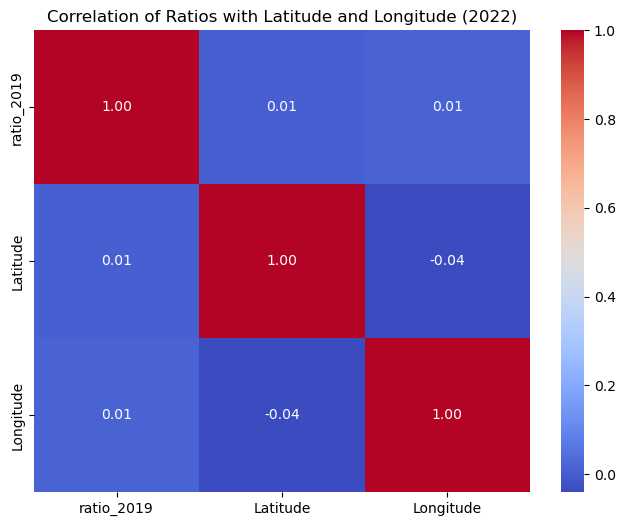

In [21]:
#SEEMS COOL BUT NEED MORE WORK ON IT 

correlation = new_dataset_with_ratios[['ratio_2019', 'Latitude', 'Longitude']].corr()

# Create heatmap of correlations
plt.figure(figsize=(8, 6))
sns.heatmap(correlation, annot=True, cmap="coolwarm", fmt=".2f")
plt.title('Correlation of Ratios with Latitude and Longitude (2022)')
plt.show()

In [23]:
supported_countries = px.data.gapminder()['country'].unique()

# Print the list of supported countries
print("Supported countries for px.choropleth:")
#for country in sorted(supported_countries):
    #print(country)

Supported countries for px.choropleth:


In [25]:
country_list = [
    'Cyprus', 'Estonia', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 
    'Armenia', 'Aruba', 'Azerbaijan', 'Barbados', 'Belarus', 'Belize', 
    'Bermuda', 'Bhutan', 'Dominica', 'Fiji', 'Georgia', 'Greenland', 
    'Grenada', 'Guyana', 'Kazakhstan', 'Kiribati', 'Maldives', 'Nauru', 
    'Qatar', 'Russia', 'Samoa', 'Seychelles', 'Suriname', 'Tajikistan', 
    'Tonga', 'Turkmenistan', 'Tuvalu', 'Ukraine', 'Uzbekistan', 'Vanuatu', 'Guam'
]

emission_countries = emissions['Country'].unique()
countries_in_emissions = [country for country in country_list if country in emission_countries]
#print("Countries from the list found in the 'emissions' dataset:")
#for country in countries_in_emissions:
    #print(country)
countries_not_in_emissions = [country for country in country_list if country not in emission_countries]

#print("\nCountries from the list NOT found in the 'emissions' dataset:")
#for country in countries_not_in_emissions:
    #print(country)

In [27]:
merged_countries = merged_df['Country Name'].unique()

countries_in_merged = [country for country in country_list if country in merged_countries]
#print("Countries from the list found in the 'merged_df' dataset:")
#for country in countries_in_merged:
    #print(country)
countries_not_in_merged = [country for country in country_list if country not in merged_countries]

#print("\nCountries from the list NOT found in the 'merged_df' dataset:")
#for country in countries_not_in_merged:
    #print(country)

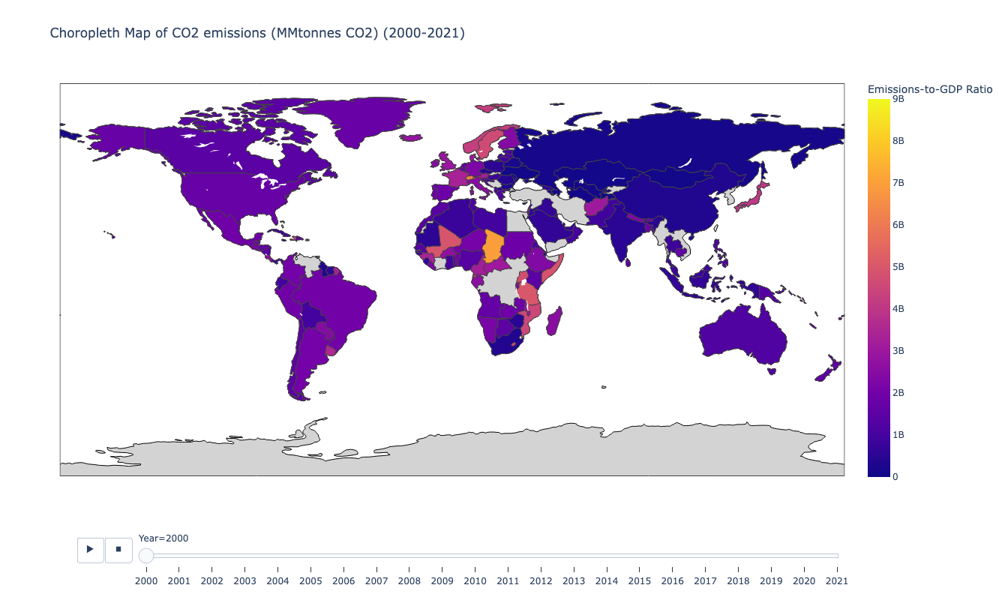

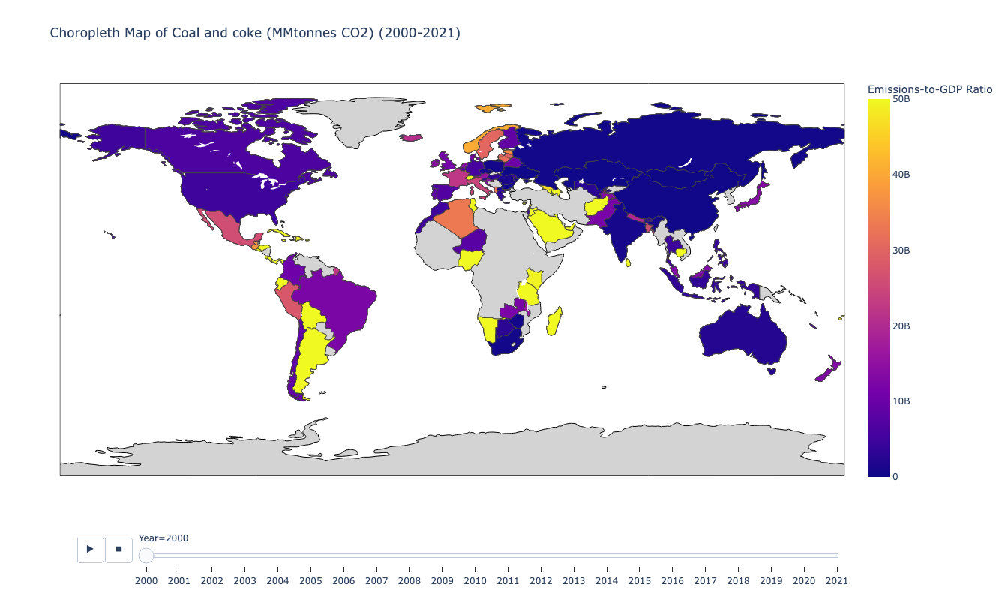

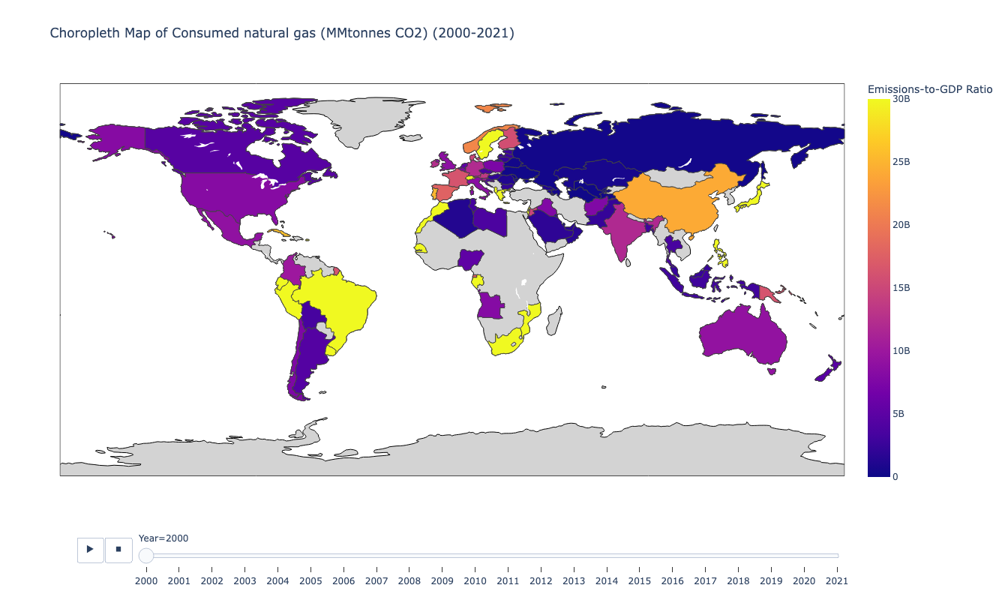

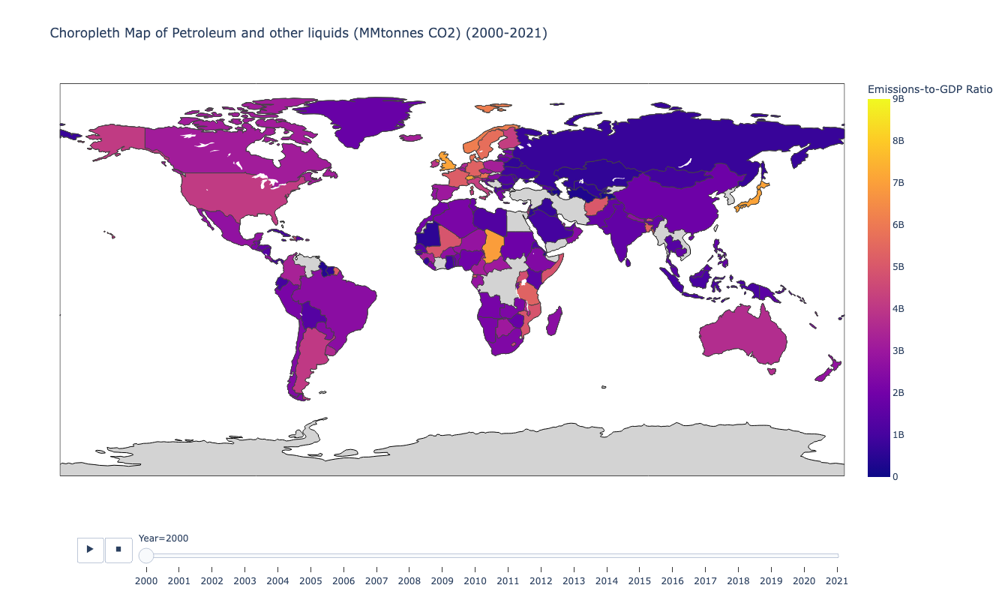

In [31]:
emission_types = [
    '        CO2 emissions (MMtonnes CO2)',
    '            Coal and coke (MMtonnes CO2)',
    '            Consumed natural gas (MMtonnes CO2)',
    '            Petroleum and other liquids (MMtonnes CO2)'
]

color_ranges = {
    '        CO2 emissions (MMtonnes CO2)': (0, 9000000000),  # Example range
    '            Coal and coke (MMtonnes CO2)': (0, 50000000000),  # Example range
    '            Consumed natural gas (MMtonnes CO2)': (0, 30000000000),  # Example range
    '            Petroleum and other liquids (MMtonnes CO2)': (0, 9000000000)  # Example range
}

for emission in emission_types:
    filtered_df = new_dataset_with_ratios[new_dataset_with_ratios['Type of Emission'] == emission]

    melted_df = filtered_df.melt(id_vars=['Country', 'Type of Emission'], 
                                 var_name='Year', 
                                 value_name='Ratio')

    melted_df['Year'] = melted_df['Year'].str.extract(r'(\d{4})')

    melted_df = melted_df.dropna(subset=['Year'])

    melted_df['Year'] = melted_df['Year'].astype(int)

    cmin, cmax = color_ranges[emission] 

    fig = px.choropleth(melted_df, 
                        locations="Country", 
                        locationmode='country names',  
                        color="Ratio", 
                        hover_name="Country", 
                        animation_frame="Year",  
                        title=f"Choropleth Map of {emission.strip()} (2000-2021)",
                        color_continuous_scale=px.colors.sequential.Plasma)

    fig.update_coloraxes(cmin=cmin, cmax=cmax, colorbar_title="Emissions-to-GDP Ratio")

    fig.update_geos(showcoastlines=True, coastlinecolor="Black", showland=True, landcolor="lightgray")

    fig.update_layout(
        width=1200,  
        height=800,  
    )

    fig.show()

In [57]:
#dfE = pd.read_csv("merged_processed_emissions_modified.csv")
#print(emissions['Type of Emission'].unique())  # Show unique values in the 'Type of Emission' column
#print(emissions['Country'].unique())

In [33]:
unique_emissions = emissions['Type of Emission'].unique()
print(unique_emissions)


[nan '    Emissions' '        CO2 emissions (MMtonnes CO2)'
 '            Coal and coke (MMtonnes CO2)'
 '            Consumed natural gas (MMtonnes CO2)'
 '            Petroleum and other liquids (MMtonnes CO2)']


In [35]:
co2_df = emissions[emissions['Type of Emission'].str.strip() == 'CO2 emissions (MMtonnes CO2)']

years = [str(year) for year in range(1980, 2023)]

co2_df.loc[:, years] = co2_df[years].apply(pd.to_numeric, errors='coerce')

co2_df = co2_df.drop_duplicates(subset=['Country'])

co2_df.set_index('Country', inplace=True)
total_emissions = co2_df[years].sum(axis=1)

sorted_emissions = total_emissions.sort_values(ascending=False)

top_20 = sorted_emissions.head(20)
bottom_20 = sorted_emissions.tail(20)

middle_index = len(sorted_emissions) // 2
if len(sorted_emissions) < 20:
    middle_20 = sorted_emissions
else:
    middle_20 = sorted_emissions.iloc[middle_index - 5: middle_index + 5]

print("Top 20 countries with highest CO2 emissions:")
print(top_20)
print("\nBottom 20 countries with lowest CO2 emissions:")
print(bottom_20)
print("\nMiddle 20 countries with CO2 emissions:")
print(middle_20)

Top 20 countries with highest CO2 emissions:
Country
Non-OPEC                 1099336.572561
Non-OECD                  621492.401469
OECD                      534792.262455
OECD-North America        264033.009115
China                     244316.443166
United States             226226.987116
OECD-Europe               179442.282205
European Union            151951.378569
OECD-Asia And Oceania      83238.135426
OPEC                       56948.091363
Russia                     52309.139521
India                      50212.609054
Japan                      48533.939993
Persian Gulf               46750.484226
Former U.S.S.R.            45510.782744
Germany                    26740.573594
United Kingdom             23047.705693
Canada                     21925.366524
South Korea                19106.821483
Italy                      17110.155212
dtype: object

Bottom 20 countries with lowest CO2 emissions:
Country
Antarctica                   6.30343
Nauru                       5.899133
Com

# New

In [48]:
#ALL FILES WITH ONLY POSITIVES VALUES (YEAR TO YEAR)

file_names = [
    "merged_processed_Coal and coke.csv",
    "merged_processed_Natural gas.csv",
    "merged_processed_Petroleum and other liquids.csv",
    "merged_processed_Biofuels.csv",
    "merged_processed_Electricity.csv",
    "merged_modified2_primary_energy.csv",
    "merged_processed_emissions_modified.csv"
]

years_range = [str(year) for year in range(2012, 2023)]

for file_name in file_names:
    df = pd.read_csv(file_name)
    
    for year in years_range:
        if year in df.columns:
            df[year] = pd.to_numeric(df[year], errors='coerce')
    
    for i in range(1, len(years_range)):
        current_year = years_range[i]
        previous_year = years_range[i - 1]
        percentage_change_column = f'% change {previous_year} to {current_year}'
        
        df.loc[:, percentage_change_column] = (
            (df[current_year] - df[previous_year]) / df[previous_year]
        ) * 100
    
    change_columns = [col for col in df.columns if col.startswith('% change')]
    df.replace([float('inf'), -float('inf')], np.nan, inplace=True)  
    df.dropna(subset=change_columns, inplace=True) 
    
    all_positive = df[change_columns].gt(0).all(axis=1)
    df = df[all_positive]
    
    df = df.drop_duplicates()
    

    print(f"Filtered unique rows with all positive % change in the dataset '{file_name}':")
    display(df)
    print("\n" + "-"*50 + "\n")

Filtered unique rows with all positive % change in the dataset 'merged_processed_Coal and coke.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
190,Tajikistan,--,--,--,--,--,--,--,--,--,...,25.242718,70.155039,18.678815,30.614203,29.316679,8.352273,6.386995,2.972200,2.878943,1.198375
2329,India,92273.03439,99564.82734,106162.3949,114563.17126,117412.4322,125679.96369,133654.08131,146937.9607,160918.62751,...,2.850213,6.654286,6.809666,3.531765,6.361582,7.690054,0.999921,0.185302,4.446065,24.482012



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_processed_Natural gas.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
827,China,505,450,381,431,438,457,484,494,491,...,6.293135,10.294746,3.392719,8.113575,7.019611,8.961409,8.450202,9.084932,8.363472,6.308812
887,Iran,250,210,250,310,476,600,536,565,706,...,1.001246,8.181029,5.905006,8.528607,6.974881,5.147711,3.843152,7.095987,2.889718,1.991171
890,Israel,5,5,3,2,2,2,1.4,2.1,1.4,...,232.116788,73.626374,7.594937,11.999898,4.822646,2.874195,0.193892,63.884600,22.763014,10.591039
965,SaudiArabia,334,564,430,418,620,716,890,946,1028,...,0.657152,2.468632,1.881533,3.458052,3.202686,1.793103,1.377597,0.899428,1.581336,5.446121
1451,PersianGulf,1357.023307,1404,1320,1454,1946,2324.19016261,2563.6323,2927,3210,...,2.430257,2.132992,4.526138,4.566538,2.200901,1.308515,3.881505,2.095309,1.885961,2.220740



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_processed_Petroleum and other liquids.csv':


,Country,1973,1974,1975,1976,1977,1978,1979,1980,1981,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
969,Turkiye,NaN,NaN,NaN,NaN,NaN,NaN,NaN,46,46,...,4.315627,4.430113,3.263781,1.979935,1.710308,10.787041,4.347097,6.581666,7.270670,3.874042
1880,Non-OPEC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2794.28975,2924.69,...,3.842383,7.326097,5.875475,2.560909,6.111813,7.738719,5.875589,3.747069,2.551081,5.135525
2089,UnitedStates,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1573.1803278688524,1590.4905753424657,...,8.210170,15.692115,10.874413,4.991920,7.795941,15.507401,10.417022,7.256016,4.837432,9.367376
2129,OECD-NorthAmerica,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2097,2180,...,6.850741,12.202737,8.444638,5.310046,6.944915,12.321528,8.997684,5.852097,3.986579,8.496232
2171,OECD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2262.08975,2339.09,...,5.613181,11.499742,7.503303,5.302366,6.850179,10.898218,7.892885,5.387268,2.902692,7.199417



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_processed_Biofuels.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
79,Ecuador,0,0,0,0,0,0,0,0,0,...,27.142857,73.033705,69.480518,31.417626,35.860058,57.180985,28.724133,15.748803,9.162998,8.393868
1575,OECD-NorthAmerica,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,40.609976,1.786193,1.914490,23.500935,2.415823,14.519118,3.967043,6.420672,10.595056,22.286789



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_processed_Electricity.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
31,Non-OECD,2555.653884367399,2576.970692164824,2778.794628835588,2921.18351415806,3123.85521323109,3291.80267126408,3385.20751151541,3570.65619621561,3758.9732536705,...,6.400351,5.330936,1.690928,3.711562,5.174844,4.495956,3.433910,1.036807,7.765933,4.104031
42,Bahrain,1.554,1.699,1.881,2.083,2.272,2.761,3.018,3.117,3.273,...,4.577047,5.189156,4.509380,0.115857,2.507338,1.098138,12.004819,0.818731,1.537862,4.889248
66,China,285.474,294.017,311.758,334.636,358.72,390.678,427.349,472.472,517.849,...,9.067975,6.673344,0.599695,5.569299,8.309731,6.447730,5.105732,3.759015,9.360223,5.116491
68,Congo-Brazzaville,0.151,0.157,0.198,0.231,0.25,0.29,0.267,0.278,0.289,...,0.544346,1.824281,59.452118,6.632838,0.377294,4.838983,18.058786,4.867172,2.561962,1.768036
94,"Gambia,The",0.037,0.045,0.044,0.045,0.047,0.048,0.053,0.058,0.061,...,1.192369,1.060487,11.115429,5.491431,5.039788,23.453283,17.412426,4.834495,3.552140,2.222916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16790,Morocco,0.512,0.634,0.643,0.657,0.695,0.718,0.704,0.704,0.835,...,52.924704,5.737538,6.118915,2.502267,7.305855,0.794593,9.217886,1.389679,7.435087,1.258418
16810,Peru,1.302,1.333,1.251,1.011,1.174,1.418,1.558,1.856,1.914,...,35.029586,9.903593,6.080542,3.420410,0.668726,7.686198,7.410822,0.048379,3.481625,2.710570
16825,Senegal,0.101,0.105,0.107,0.106,0.117,0.129,0.123,0.154,0.15,...,5.516014,1.011804,5.342237,6.180666,0.223881,0.044676,21.315868,12.760736,10.990207,3.627000
16859,Vietnam,0.629,0.678,0.714,0.726,0.912,0.928,1.104,1.102,1.27,...,7.344844,11.954443,0.442650,5.520334,3.480363,9.063230,0.493410,1.343756,4.832027,3.884463



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_modified2_primary_energy.csv':


,Country,Type of Energy,1980,1981,1982,1983,1984,1985,1986,1987,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
134,Hungary,Renewables and other (quad Btu),0.00037874772127720135,0.000566415511099238,0.0005391183780342145,0.0005220576698685748,0.0006107733523299013,0.0005220576698685748,0.0005186455282354469,0.000569827652732366,...,7.662292,9.379579,8.926017,2.853921,3.640679,6.347134,7.651277,2.068759,14.121262,1.351591
252,Non-OECD,"Nuclear, renewables, and other (quad Btu)",3.2808137936813333,3.2963145572842114,3.814774917672326,4.234636453928651,5.02730417255354,5.541161185459979,5.434169778849863,5.869964531088529,...,6.498987,7.181028,4.359291,8.272264,6.344751,8.166355,8.712553,4.832738,6.766020,7.622634
253,Non-OECD,Nuclear (quad Btu),1.0350903150187916,1.0055913320067882,1.4446296545456598,1.6989466339634203,2.22415398833154,2.6330296226406205,2.407096878146652,2.7539807495156325,...,0.971914,7.669621,7.736247,7.028387,5.953903,5.781887,11.675853,3.609491,6.383834,2.048604
254,Non-OECD,Renewables and other (quad Btu),2.2457234786625415,2.2907232252774232,2.370145263126666,2.5356898199652305,2.8031501842220004,2.9081315628193583,3.027072900703211,3.115983781572897,...,9.339167,6.949170,2.745986,8.895376,6.537187,9.333930,7.308688,5.435836,6.951186,10.308875
530,China,Natural gas (quad Btu),0.581255,0.51795,0.438531,0.496081,0.504138,0.526007,0.557084,0.568594,...,8.742148,9.380703,7.626632,2.175041,7.461428,8.961409,8.450202,9.084932,8.363472,6.308812
532,China,"Nuclear, renewables, and other (quad Btu)",0.19660077661756564,0.22126032420018127,0.25132470412967156,0.2918609467312315,0.29321215481795015,0.31212906803201146,0.3192229104872844,0.33847762572302537,...,12.225436,16.577396,12.339699,13.476155,11.922900,12.560101,12.837168,8.240645,7.999599,12.334902
533,China,Nuclear (quad Btu),0,0,0,0,0,0,0,0,...,15.012531,18.928961,29.367082,25.141753,16.420351,18.869046,18.410841,5.251118,4.663715,9.067072
534,China,Renewables and other (quad Btu),0.19660077661756564,0.22126032420018127,0.25132470412967156,0.2918609467312315,0.29321215481795015,0.31212906803201146,0.3192229104872844,0.33847762572302537,...,11.494339,15.941080,7.613481,9.583642,10.209156,10.020606,10.413199,9.634952,9.493234,13.733529
882,Iran,Natural gas (quad Btu),0.264,0.22176,0.264,0.32736,0.502656,0.6336,0.566016,0.59664,...,1.001246,8.181029,5.905006,8.528607,6.974881,5.147711,3.843152,7.095987,2.889718,1.991171
1032,Maldives,Production (quad Btu),0,0,0,0,0,0,0,0,...,25.000000,60.000000,12.500000,44.444444,38.461538,50.000000,22.222222,27.272727,20.952381,13.307087



--------------------------------------------------

Filtered unique rows with all positive % change in the dataset 'merged_processed_emissions_modified.csv':


,Country,Type of Emission,1949,1950,1951,1952,1953,1954,1955,1956,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
664,Iran,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.532616,10.056447,7.172988,6.804156,4.160026,4.862450,1.567170,5.740109,3.540773,1.508808
782,Mali,CO2 emissions (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,10.324953,7.250956,8.463655,41.175265,10.597689,6.348367,5.441616,5.815239,13.498829,3.148793
785,Mali,Petroleum and other liquids (MMton...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,10.324953,7.250956,8.463655,41.175265,10.597689,6.348367,5.441616,5.815239,13.498829,3.143865
1048,SaudiArabia,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.657152,2.468632,1.881533,3.458052,3.202686,1.793103,1.377597,0.899428,1.581336,5.446121
1137,Tajikistan,Coal and coke (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21.272524,69.246578,18.841762,32.015933,18.586566,14.165008,8.960416,4.865117,2.980709,6.907755
2608,PersianGulf,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3.099233,4.180854,5.729804,3.662953,3.581678,2.352198,4.159682,2.557185,2.055308,1.901821
2710,OPEC,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.964859,5.830665,5.887489,3.455245,5.237924,1.496624,2.361742,0.841505,3.097772,2.662068



--------------------------------------------------



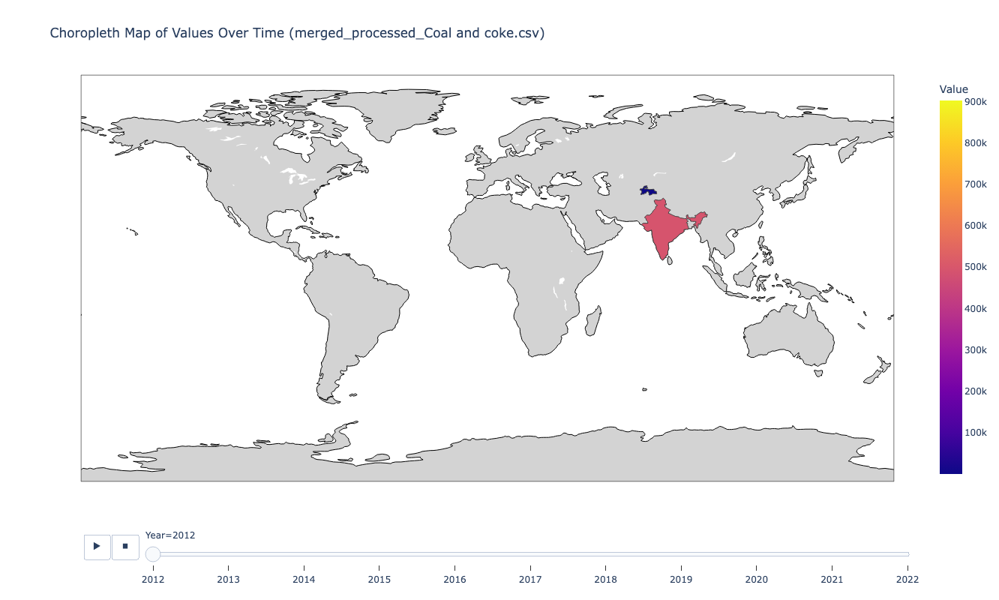

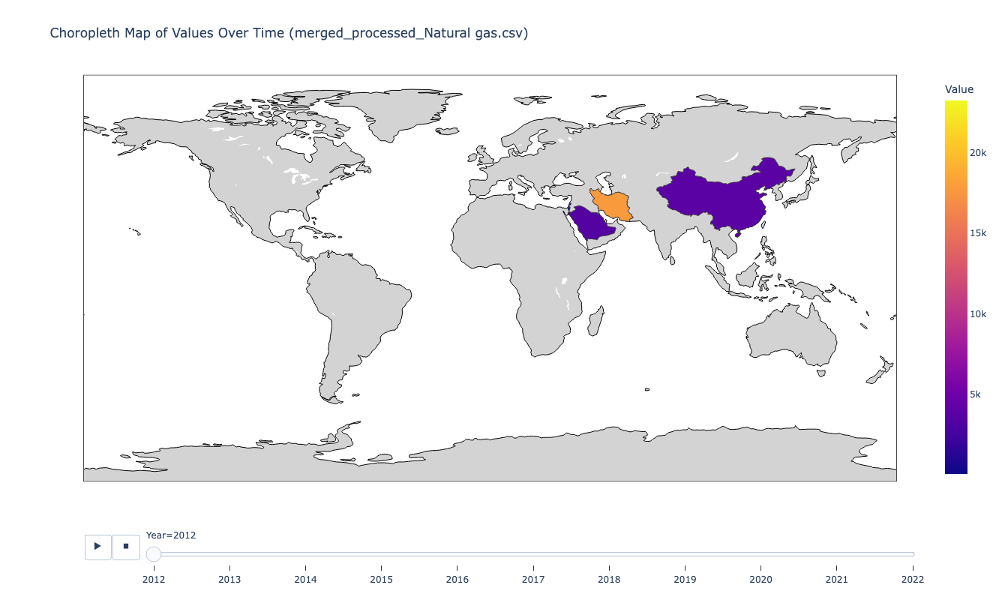

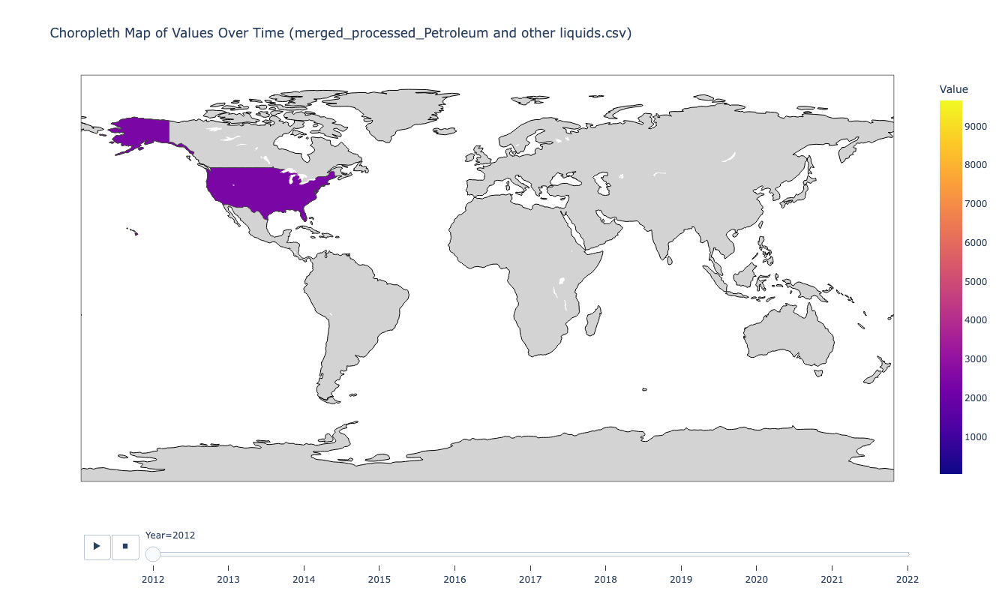

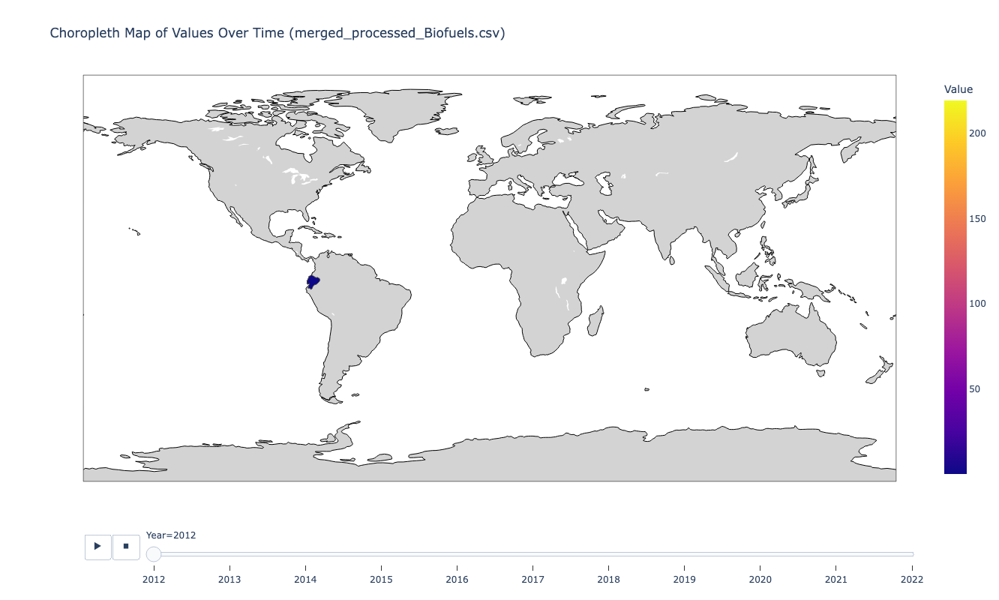

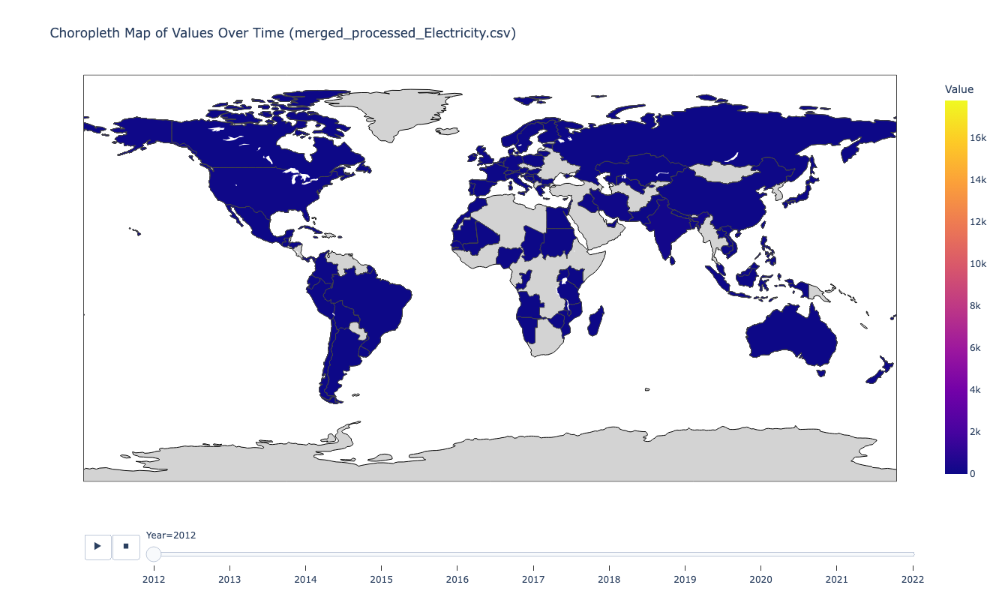

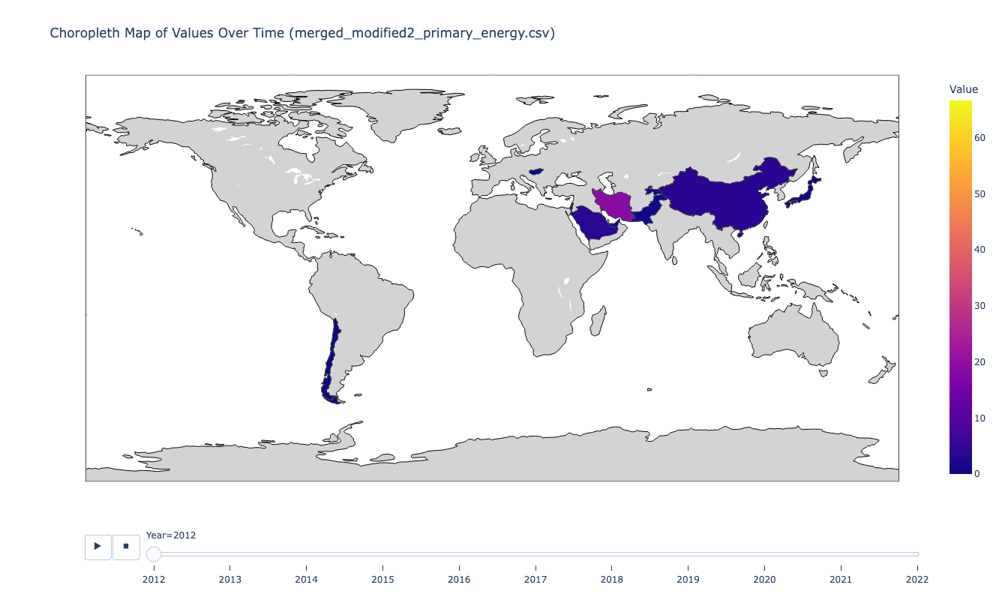

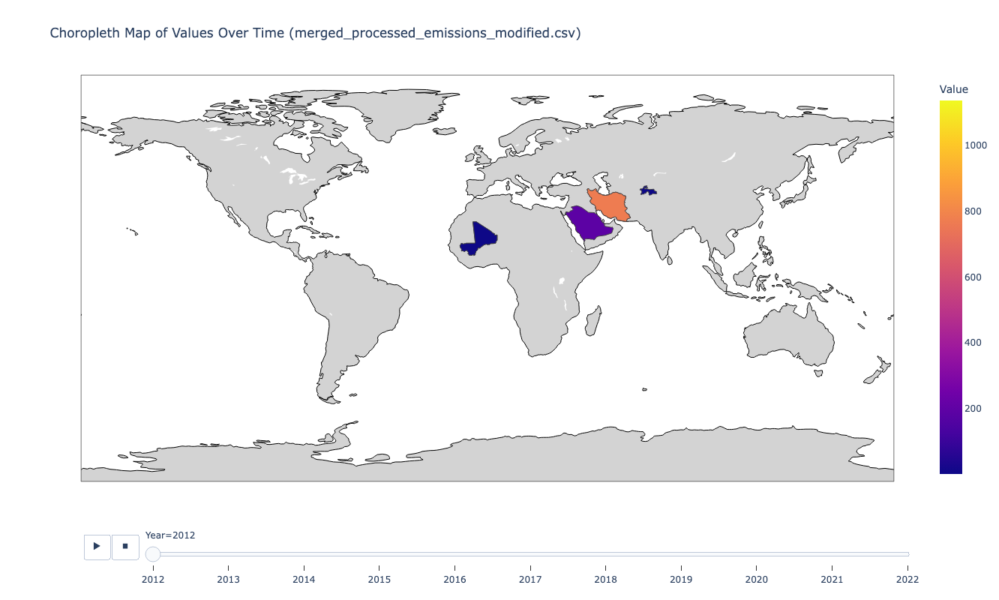

In [50]:
#only positive change year to year 

years_range = [str(year) for year in range(2012, 2023)]

for file_name in file_names:
    df = pd.read_csv(file_name)
    for year in years_range:
        if year in df.columns:
            df[year] = pd.to_numeric(df[year], errors='coerce')
    for i in range(1, len(years_range)):
        current_year = years_range[i]
        previous_year = years_range[i - 1]
        percentage_change_column = f'% change {previous_year} to {current_year}'
        
        df[percentage_change_column] = (
            (df[current_year] - df[previous_year]) / df[previous_year]
        ) * 100

    change_columns = [col for col in df.columns if col.startswith('% change')]
    df.replace([float('inf'), -float('inf')], np.nan, inplace=True)  
    df.dropna(subset=change_columns, inplace=True) 
    
    all_positive = df[change_columns].gt(0).all(axis=1)
    df = df[all_positive]
    
    df = df.drop_duplicates()
    
    melted_df = df.melt(id_vars=['Country'], 
                        value_vars=years_range, 
                        var_name='Year', 
                        value_name='Value')
    
    melted_df['Year'] = melted_df['Year'].astype(int)
    
    fig = px.choropleth(melted_df, 
                        locations="Country", 
                        locationmode='country names',  
                        color="Value", 
                        hover_name="Country", 
                        animation_frame="Year",  
                        title=f"Choropleth Map of Values Over Time ({file_name})",
                        color_continuous_scale=px.colors.sequential.Plasma)
    
    fig.update_coloraxes(cmin=melted_df['Value'].min(), 
                         cmax=melted_df['Value'].max(), 
                         colorbar_title="Value")
    
    fig.update_geos(showcoastlines=True, coastlinecolor="Black", showland=True, landcolor="lightgray")
    
    fig.update_layout(
        width=1200,  # Adjust width as needed
        height=800,  # Adjust height as needed
    )
    
    # Show the plot
    fig.show()

In [115]:
#how value changes from year to year
years_range = [str(year) for year in range(2012, 2023)]

for file_name in file_names:
    df = pd.read_csv(file_name)

    for year in years_range:
        if year in df.columns:
            df[year] = pd.to_numeric(df[year], errors='coerce')
            
    for i in range(1, len(years_range)):
        current_year = years_range[i]
        previous_year = years_range[i - 1]
        percentage_change_column = f'% change {previous_year} to {current_year}'
        
        df.loc[:, percentage_change_column] = (
            (df[current_year] - df[previous_year]) / df[previous_year]
        ) * 100
    df = df.drop_duplicates()
    
    print(f"Head of the dataset '{file_name}':")
    display(df.head())
    print("\n" + "-"*50 + "\n")
    
    # Save the updated DataFrame to a new CSV file
    #output_file_name = f"updated_{file_name}"
    #df.to_csv(output_file_name, index=False)
    #print(f"Processed and saved: {output_file_name}\n")
    

Head of the dataset 'merged_processed_Coal and coke.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,coalproduction(Mst),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,EuropeanUnion,1116683.2274600000,1103812.6619700100,1154916.8650350000,1167270.4595300000,1199325.086485000,1219446.0983500100,1223798.5670000000,1223504.79602,1218025.2061200000,...,-7.111451,-3.036230,-0.556546,-7.472025,1.223455,-4.435736,-15.299024,-19.238554,10.270050,5.344983
2,Austria,3158.11815,3374.17091,3634.31607,3352.12471,3227.56368,3396.21711,3272.75839,3071.03566,2346.81799,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Belgium,6971.00844,6818.88966,7248.79056,6745.03489,6990.85002,6875.10747,6200.49375,4817.0947,2741.44497,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Bulgaria,33304.09203,32232.64671,35510.91665,35703.8209,37099.34536,34039.3328,38826.66513,40585.95189,37640.57957,...,-14.377599,9.248454,14.682743,-12.906104,9.754225,-11.711416,-7.475589,-20.364403,26.866351,25.545914



--------------------------------------------------

Head of the dataset 'merged_processed_Natural gas.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,World,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.927998,1.644214,1.424790,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,0.000000,18.421053,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Albania,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.764706,68.421053,9.375000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Algeria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.702638,4.030308,-1.553094,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AmericanSamoa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN



--------------------------------------------------

Head of the dataset 'merged_processed_Petroleum and other liquids.csv':


,Country,1973,1974,1975,1976,1977,1978,1979,1980,1981,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,EuropeanUnion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,670.4,679.4,...,1.685368,0.187578,-1.310566,-11.183231,-0.460962,0.822965,-4.692445,3.359724,-0.293394,-3.371952
1,Austria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,28,...,-25.371999,14.316798,2.366764,-7.011841,-7.405581,-0.970551,-1.785380,-7.469564,1.778345,-3.837715
2,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,8,...,3.550033,21.525448,-17.426444,-5.452819,-1.538516,-3.656676,28.948358,-2.915886,4.862649,-0.752376
3,Bulgaria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,3,...,8.222984,-22.030049,38.251764,6.501470,43.828805,0.314273,0.375946,-1.466940,2.410496,-0.382238
4,Croatia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,--,--,...,-0.877404,-2.700163,-7.411563,-1.254464,2.316061,0.089883,-2.016296,-10.164369,-2.035206,-2.648793



--------------------------------------------------

Head of the dataset 'merged_processed_Biofuels.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,biofuelsproduction(Mb/d),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,EuropeanUnion,0,0,0,0,0,0,0,0,0,...,5.275179,10.074007,-1.424716,-3.329720,8.457052,5.178384,6.069507,-3.305799,3.404834,-0.792985
2,Austria,0,0,0,0,0,0,0,0,0,...,-4.803761,66.162629,12.553950,-7.467063,-9.871753,-0.958203,9.603703,-13.909426,14.186911,8.283864
3,Belgium,0,0,0,0,0,0,0,0,0,...,-5.929810,26.278083,-29.280820,-3.354816,19.021746,-2.760614,6.928977,6.489302,-6.670878,-2.839010
4,Bulgaria,0,0,0,0,0,0,0,0,0,...,616.352392,45.526458,-9.171141,22.174842,26.009498,25.842558,29.937693,-18.980400,43.351370,36.666916



--------------------------------------------------

Head of the dataset 'merged_processed_Electricity.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,EuropeanUnion,1666.764,1658.983,1671.952,1720.898,1818.811,1895.835,1947.073,2000.525,2028.342,...,-0.668317,-2.077148,1.760948,0.847795,1.192990,-0.556501,-1.953361,-3.717690,3.771754,-3.277296
1,Austria,40.574,41.233,41.458,41.191,40.97,43.033,43.295,38.842,47.491,...,-5.940169,-4.982787,1.055424,5.798817,3.228791,-4.030641,11.970216,-1.060287,-1.443754,-12.996800
2,Belgium,50.572,47.537,47.25,49.041,50.813,53.112,54.576,59.154,61.423,...,0.118798,-13.056046,-3.608171,25.881660,1.196768,-12.938293,24.850915,-5.146572,11.590738,-6.590920
3,Bulgaria,32.854,34.868,38.112,40.185,42.08,39.184,39.354,40.916,42.409,...,-7.580669,9.481909,3.988812,-8.845013,0.986879,3.949342,-5.992217,-8.411608,18.229536,8.251284
4,Croatia,--,--,--,--,--,--,--,--,--,...,31.864862,-4.061431,-15.658903,9.332554,-6.117899,14.187312,-7.270257,6.055866,17.106023,-5.733218



--------------------------------------------------

Head of the dataset 'merged_modified2_primary_energy.csv':


,Country,Type of Energy,1980,1981,1982,1983,1984,1985,1986,1987,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,EuropeanUnion,Production (quad Btu),25.42247280375135,25.631617303101056,26.23464075598175,27.03336715024558,29.87214382296293,31.137242017943567,31.50747561939628,31.756826907665292,...,-0.647453,-2.926640,-3.734182,-3.219109,-1.267512,-1.612229,-4.389818,-8.635834,3.949066,-7.853971
1,EuropeanUnion,Coal (quad Btu),15.974465135754876,15.686072870597357,16.431467059160603,16.462883846026156,16.814796294305236,17.095813338864456,17.101171578290174,16.932104637775158,...,-6.885763,-4.628753,-1.114589,-6.779699,-1.047923,-5.245709,-13.729684,-16.915903,7.934225,-1.888681
2,EuropeanUnion,Natural gas (quad Btu),6.3089346,6.1652379,5.78354,5.9876936,6.0493976,6.0777928,5.8725963,5.9611368,...,1.016095,-15.224249,-14.887360,-1.408249,-5.729923,-10.741409,-11.764340,-20.898342,-7.584161,-7.550793
3,EuropeanUnion,Petroleum and other liquids (quad Btu),0,0,0,0,1.3186148767404968,1.3654111786397638,1.4233188047462118,1.4674480909122611,...,-2.930448,-0.894664,-4.064774,-12.126061,-3.075712,-2.536347,-6.937942,-0.247534,-4.204860,-7.048415
4,EuropeanUnion,"Nuclear, renewables, and other (quad Btu)",3.139073067996473,3.7803065325036975,4.019633696821149,4.582789704219429,5.6893350519171975,6.5982247004393475,7.110388936359894,7.396137378977874,...,2.338214,2.107409,-1.589343,-1.233639,-0.071708,2.228108,1.075486,-4.144953,5.118188,-9.750586



--------------------------------------------------

Head of the dataset 'merged_processed_emissions_modified.csv':


,Country,Type of Emission,1949,1950,1951,1952,1953,1954,1955,1956,...,% change 2012 to 2013,% change 2013 to 2014,% change 2014 to 2015,% change 2015 to 2016,% change 2016 to 2017,% change 2017 to 2018,% change 2018 to 2019,% change 2019 to 2020,% change 2020 to 2021,% change 2021 to 2022
0,EuropeanUnion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,EuropeanUnion,Emissions,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,EuropeanUnion,CO2 emissions (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.957217,-4.279407,1.818522,0.207964,2.240288,-1.711575,-3.885586,-12.336973,7.018529,-1.780892
3,EuropeanUnion,Coal and coke (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.321066,-3.945432,-0.399568,-4.646993,0.503613,-5.463489,-18.059700,-19.323020,12.942696,2.062313
4,EuropeanUnion,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.804419,-11.133336,4.266176,5.655193,5.290375,-1.481060,3.339907,-4.434899,5.009212,-14.664479



--------------------------------------------------



In [117]:
#GREATER THAN 100 ALL FILES (based on 1980)

import numpy as np  

years = [str(year) for year in range(2013, 2023)]

for file_name in file_names:
    df = pd.read_csv(file_name)
    
    filtered_df = df.copy()
    
    for year in years:
        if year in filtered_df.columns:
            filtered_df[year] = pd.to_numeric(filtered_df[year], errors='coerce')
    if '1980' in filtered_df.columns:
        filtered_df['1980'] = pd.to_numeric(filtered_df['1980'], errors='coerce')

    for year in years:
        if '1980' in filtered_df.columns and year in filtered_df.columns:
            change_col = f'% change of {year}'
            filtered_df.loc[:, change_col] = (filtered_df[year] / filtered_df['1980']) * 100

    change_columns = [col for col in filtered_df.columns if col.startswith('% change')]

    filtered_df.replace([float('inf'), -float('inf')], np.nan, inplace=True)  
    filtered_df.dropna(subset=change_columns, inplace=True) 
 
    filtered_df = filtered_df[filtered_df[change_columns].gt(100).any(axis=1)]
    
    print(f"Filtered rows with % change > 100 in the dataset '{file_name}':")
    display(filtered_df)
    print("\n" + "-"*50 + "\n") 
    
    
    #output_file_name = f"updated_based_on_1980_{file_name}"
    #filtered_df.to_csv(output_file_name, index=False)
    #print(f"Processed and saved: {output_file_name}\n")

Filtered rows with % change > 100 in the dataset 'merged_processed_Coal and coke.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
4,Bulgaria,3.330409e+04,32232.64671,35510.91665,35703.8209,37099.34536,34039.3328,38826.66513,40585.95189,37640.57957,...,94.730745,103.491874,118.687320,103.369411,113.452295,100.165425,92.677470,73.804256,93.632767,117.552113
16,Greece,2.557139e+04,30109.59765,30202.19169,33724.07214,35827.27962,39559.70128,41993.60176,49176.25372,53266.92613,...,232.451073,219.178377,199.353393,140.693163,162.649142,157.292870,118.007802,60.581085,52.139154,59.070291
32,Non-OECD,1.905540e+06,1933698.3133450400,2031831.008277780,2112326.448140470,2230880.328000700,2359993.362863110,2441158.722777260,2515135.8098367300,2625188.2300021600,...,352.086339,346.149797,341.156191,323.976453,334.163206,354.324782,367.774131,362.391083,381.396549,409.029048
33,Afghanistan,1.311750e+02,137.78892,159.83515,159.83515,163.14208,166.44902,176.36982,184.086,152.11897,...,1545.770274,1978.848628,1732.627214,1920.859066,1739.270382,2385.480836,2530.514315,1488.389358,2259.441657,4105.190659
50,Bhutan,5.512000e-02,0.09921,0.1433,0.18739,0.44092,0.443122,0.88185,2.01723,2.0242854,...,155475.305951,163768.628828,170314.094412,235540.768868,323973.548621,373969.466618,369969.793179,314586.357039,371969.629898,354759.789695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3843,Chile,3.339999e+02,350.53458,275.5775,277.78212,319.6699,331.79531,335.10224,369.27385,337.30686,...,144.554455,142.574257,133.663366,132.013201,122.013201,129.582178,123.996700,126.267657,159.258086,159.645875
3844,Colombia,5.533596e+02,491.63026,501.55105,497.14181,470.68637,460.76558,593.04278,739.65001,626.11208,...,486.254980,497.011952,484.262948,471.912351,514.870319,630.094422,634.960159,675.774900,338.188247,880.741633
3869,NewZealand,1.433003e+01,12.12541,8.81848,7.71617,8.81848,5.51155,4.40924,0,0,...,3776.923077,3869.230769,3876.923077,3861.538462,3915.384615,3741.246154,3271.707692,3130.769231,3430.769231,3065.230769
3876,SouthKorea,3.268349e+03,4851.26631,5002.28278,5161.01542,5730.90969,5790.43443,5782.71826,6902.66522,8038.04452,...,516.694772,573.625632,590.927487,537.065767,540.288027,569.767218,545.577201,517.555413,522.554233,498.313659



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_processed_Natural gas.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
786,World,53360.742307,54740.061,54563.957,55146.063,60028.777,62304.44316261,63588.3623,66582.381,69840.421,...,228.036852,231.253480,235.455088,238.348152,245.443855,257.447668,265.770209,259.165077,270.206053,271.863295
789,Algeria,411.000000,772,942,1314,1360,1360,1330,1525,1635,...,684.372049,715.708741,713.517664,805.842835,818.641320,826.640948,765.141548,724.501415,895.970254,865.478401
791,Angola,9.200000,8.8,10,12,12,13,14,16,18,...,355.069293,280.600707,296.722772,657.546880,2215.789130,2479.391630,2597.821739,2884.346196,2322.758261,2116.460652
794,Argentina,280.000000,346,399,445,494,500,547,527,632,...,448.500500,447.743750,459.095000,495.242118,516.027341,529.148825,551.463855,505.802558,509.861444,545.858173
797,Australia,313.000000,366,403,422,441,463,516,532,555,...,696.427596,706.773875,813.472785,1044.445150,1230.448199,1426.442148,1637.349301,1633.256709,1659.928056,1735.075914
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,Mexico,900.000000,969,1045,1027,1009,999,886,898,905,...,177.083222,174.099222,158.415000,143.990012,123.862993,114.652146,114.123508,115.116654,116.660347,123.293841
1555,NewZealand,40.000000,47,81,86,106,133,159,152,166,...,422.985412,462.714788,437.376275,447.264391,450.884148,397.724431,421.227198,412.580070,365.778501,332.874758
1556,Norway,917.000000,924,902,912,967,943,992,1042,1052,...,418.812023,419.081603,451.354198,449.049923,477.960334,467.960232,443.663852,432.294488,443.794044,476.484609
1569,UnitedKingdom,1323.000000,1327,1365,1403,1364,1522,1596,1679,1617,...,102.853937,100.538900,107.973889,111.139351,112.333708,108.935868,105.091899,105.216266,86.900447,100.788167



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_processed_Petroleum and other liquids.csv':


,Country,1973,1974,1975,1976,1977,1978,1979,1980,1981,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
0,EuropeanUnion,NaN,NaN,NaN,NaN,NaN,NaN,NaN,670.4,679.4,...,175.599031,175.928416,173.622759,154.206125,153.495294,154.758507,147.496550,152.452027,152.004742,146.879215
1,Austria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.0,28,...,89.940014,102.816543,105.249968,97.870007,90.622164,89.742630,88.140384,81.556681,83.007041,79.821467
2,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,8,...,262.300000,318.761250,263.212500,248.860000,245.031250,236.071250,304.410000,295.533750,309.904518,307.572870
3,Bulgaria,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,3,...,122.046667,95.159726,131.560000,140.113333,201.523333,202.156667,202.916667,199.940000,204.759546,203.976877
7,Denmark,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.3,15,...,3387.918248,3191.775704,3047.871233,2686.113434,2689.732851,2263.780358,2021.874060,1443.930082,1310.583389,1323.322624
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3242,UnitedStates,NaN,NaN,NaN,NaN,NaN,NaN,NaN,595.0,508,...,182.632924,181.599162,178.478194,187.894128,186.767365,191.280305,179.638537,155.104004,160.618402,173.470739
3243,OECD-AsiaAndOceania,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.0,51,...,340.637000,344.746600,358.283800,324.406600,357.098800,357.449400,366.866800,347.506800,380.059812,374.778230
3250,OECD-Europe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61.3,57.9,...,437.043883,434.441272,451.911256,420.755791,439.177162,441.442904,467.250734,441.692333,483.199327,476.355198
3281,OECD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,757.3,664.9,...,214.060478,213.372325,213.551057,215.464368,218.747712,222.266092,217.185118,193.795711,204.877249,213.871287



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_processed_Biofuels.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
32,Non-OECD,64.6,72.7,101,137.1,195.2,205,182.2,198.3,203.3,...,1154.196656,1247.433359,1228.240518,1265.157786,1298.212932,1558.225726,1830.149753,1732.926057,1702.227594,1833.857557
54,Brazil,64.0,72,100,136,194,204,181,197,202,...,734.903238,780.727060,841.350119,789.660418,793.239143,959.071328,1085.241557,1006.267443,889.703265,924.683281
216,Non-OPEC,64.6,78.1,116,164.1,228.2,245,228.2,251.3,257.3,...,3157.433792,3411.982538,3433.590360,3560.256887,3694.948017,4025.984739,4301.012405,4002.638316,4101.829523,4350.448602
241,Brazil,64.0,72,100,136,194,204,181,197,202,...,734.903238,780.727060,841.350119,789.660418,793.239143,959.071328,1085.241557,1006.267443,889.703265,924.683281
587,Non-OECD,64.6,72.7,101,137.1,195.2,205,182.2,198.3,203.3,...,820.122192,861.783338,911.326976,868.034880,876.654323,1039.394960,1209.123499,1105.476287,1016.907121,1098.331795
609,Brazil,64.0,72,100,136,194,204,181,197,202,...,655.929124,688.433632,733.181145,687.384231,677.266934,813.500644,925.813405,831.367361,704.847332,742.652657
771,Non-OPEC,64.6,78.1,116,164.1,228.2,245,228.2,251.3,257.3,...,2341.525748,2492.699288,2589.152578,2609.322020,2676.116610,2857.744742,2990.468718,2690.227407,2686.210387,2829.470894
796,Brazil,64.0,72,100,136,194,204,181,197,202,...,655.929124,688.433632,733.181145,687.384231,677.266934,813.500644,925.813405,831.367361,704.847332,742.652657



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_processed_Electricity.csv':


,Country,1980,1981,1982,1983,1984,1985,1986,1987,1988,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
0,EuropeanUnion,1666.764000,1658.983,1671.952,1720.898,1818.811,1895.835,1947.073,2000.525,2028.342,...,168.895590,165.387379,168.299765,169.726602,171.751424,170.795626,167.459370,161.233750,167.315091,161.831680
1,Austria,40.574000,41.233,41.458,41.191,40.97,43.033,43.295,38.842,47.491,...,153.923695,146.254005,147.797604,156.368118,161.416917,154.910780,173.453936,171.614827,169.137132,147.154718
2,Belgium,50.572000,47.537,47.25,49.041,50.813,53.112,54.576,59.154,61.423,...,156.647947,136.195919,131.281737,165.259630,167.237404,145.599739,181.782607,172.427035,192.412600,179.730838
3,Bulgaria,32.854000,34.868,38.112,40.185,42.08,39.184,39.354,40.916,42.409,...,127.228344,139.292019,144.848116,132.036282,133.339319,138.605345,130.299811,119.339502,141.094539,152.736650
5,Cyprus,0.968000,0.993,1.071,1.148,1.175,1.24,1.338,1.421,1.568,...,443.491736,449.070248,468.450413,504.917355,516.983471,522.778926,531.146694,500.940083,528.553719,543.464143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17198,Switzerland,3.198000,3.214,3.195,3.257,3.348,3.444,3.485,3.551,3.571,...,145.841151,146.150719,141.954346,139.349593,142.548468,132.342089,130.037523,134.055660,149.312070,146.278540
17199,Turkiye,2.824000,2.931,3.317,3.422,3.74,3.945,5.447,5.518,6.308,...,1314.943343,1321.919263,1293.484419,1239.946884,1228.930595,1115.612606,1106.947592,1031.388102,1081.905099,1078.330053
17201,U.S.VirginIslands,0.052430,0.05537,0.05607,0.05761,0.05789,0.05922,0.06055,0.06335,0.06384,...,114.438299,114.438299,114.438299,123.974824,95.365249,97.272554,97.272554,95.365249,95.365249,95.365249
17202,UnitedKingdom,21.534000,20.123,20.479,21.206,23.055,24.603,25.065,26.692,23.754,...,123.293396,127.463546,132.845732,122.274078,124.616885,119.366119,118.183338,122.237856,117.677626,121.319773



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_modified2_primary_energy.csv':


,Country,Type of Energy,1980,1981,1982,1983,1984,1985,1986,1987,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
4,EuropeanUnion,"Nuclear, renewables, and other (quad Btu)",3.139073,3.7803065325036975,4.019633696821149,4.582789704219429,5.6893350519171975,6.5982247004393475,7.110388936359894,7.396137378977874,...,386.956304,395.111058,388.831386,384.034610,383.759228,392.309798,396.529037,380.093095,399.546975,360.588806
5,EuropeanUnion,Nuclear (quad Btu),2.017557,2.6802033891115076,2.9365320014698155,3.4871658405621866,4.561760587910947,5.466393697750254,6.023479532302228,6.252353645147975,...,393.262339,396.363370,384.019612,374.536496,370.679042,372.072766,374.178728,332.753879,358.207875,299.049745
6,EuropeanUnion,Renewables and other (quad Btu),1.121517,1.10010314339219,1.0831016953513333,1.0956238636572428,1.12757446400625,1.1318310026890939,1.086909404057666,1.1437837338298995,...,375.612038,392.858206,397.487546,401.121277,407.289877,428.715285,436.736211,465.254159,473.914110,471.294736
8,Austria,Production (quad Btu),0.214524,0.20308771757966934,0.20358540659654842,0.19465566511824595,0.24583076571131385,0.24855600126250232,0.24598271031742397,0.224200741426821,...,139.357920,139.362230,135.085982,136.691882,136.604378,129.810964,136.705721,133.269717,130.578201,114.080643
12,Austria,"Nuclear, renewables, and other (quad Btu)",0.100449,0.10568437863297962,0.10727864132139782,0.10646519280956139,0.10479539790735884,0.11256158227058458,0.11370917590555803,0.09559084383946011,...,208.459984,210.892830,205.322160,215.906047,214.956422,211.012038,231.190940,233.570029,230.595704,199.573736
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4426,UnitedStates,Natural gas (quad Btu),19.907600,19.699155047,18.319024764,16.593389291,18.007932632,16.980380424,16.5408009,17.135819011,...,124.872271,134.210414,140.985763,138.520078,142.103191,160.150635,176.752513,176.124398,179.865273,189.182681
4427,UnitedStates,Petroleum and other liquids (quad Btu),20.473758,20.412303121,20.458149338,20.528111329,21.082043165,21.196174616,20.4887396,19.853719522,...,94.360525,110.459526,118.069690,113.274012,119.830007,139.372948,156.082454,148.383845,148.971121,158.507264
4428,UnitedStates,"Nuclear, renewables, and other (quad Btu)",6.184547,6.523510617,6.876944163,7.27171313,7.65665123,8.093736604,8.350582044,8.528376112,...,239.390465,245.339677,245.495964,252.486883,257.473393,261.656394,262.018699,254.121718,257.710289,264.665490
4429,UnitedStates,Nuclear (quad Btu),2.739169,3.007588734,3.131148173,3.202548979,3.552530566,4.0755629,4.380108667,4.753933331,...,300.983038,304.382824,304.358263,307.639067,307.354865,308.052156,308.555349,301.225501,296.838728,294.287112



--------------------------------------------------

Filtered rows with % change > 100 in the dataset 'merged_processed_emissions_modified.csv':


,Country,Type of Emission,1949,1950,1951,1952,1953,1954,1955,1956,...,% change of 2013,% change of 2014,% change of 2015,% change of 2016,% change of 2017,% change of 2018,% change of 2019,% change of 2020,% change of 2021,% change of 2022
4,EuropeanUnion,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,163.411406,145.218266,151.413533,159.976260,168.439605,165.944913,171.487318,163.882029,172.091227,146.854946
8,Austria,CO2 emissions (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,116.600331,110.628925,114.337937,115.359235,120.032804,115.393717,118.272517,104.525416,110.220103,104.729226
10,Austria,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,168.038487,153.385263,163.673885,170.926407,185.531992,172.851056,180.530524,171.647799,181.756501,159.075947
11,Austria,Petroleum and other liquids (MMton...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,110.614317,107.360476,108.209346,110.024667,111.605590,112.106336,114.300468,97.221354,103.292174,100.898990
16,Belgium,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,161.828225,141.747179,155.067777,157.646789,159.438523,164.281152,165.554627,164.621586,165.153852,138.873786
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3316,UnitedKingdom,Consumed natural gas (MMtonnes CO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,163.128688,148.984968,152.338249,171.515985,166.882873,166.489089,164.335933,154.922337,160.524201,148.338985
3320,UnitedStates,CO2 emissions (MMtonnes CO2),2206.690829,2382.046176,2526.687327,2473.373964,2536.892888,2422.252560,2684.786146,2777.042758,...,112.671311,113.827912,110.635782,108.677209,107.888470,110.965493,108.213583,96.370360,103.116735,103.887623
3321,UnitedStates,Coal and coke (MMtonnes CO2),1117.538985,1151.600346,1166.858975,1052.386511,1057.069608,904.191799,1037.883229,1054.597765,...,118.162858,117.854874,101.933143,93.218177,90.656034,86.845551,74.117783,60.269574,68.967861,64.565505
3322,UnitedStates,Consumed natural gas (MMtonnes CO2),269.537229,312.826758,369.725933,396.144693,414.852766,437.259069,472.164274,504.395476,...,133.110392,135.866051,139.773995,140.810515,139.025464,153.764137,159.219074,156.230279,156.525057,164.655416



--------------------------------------------------



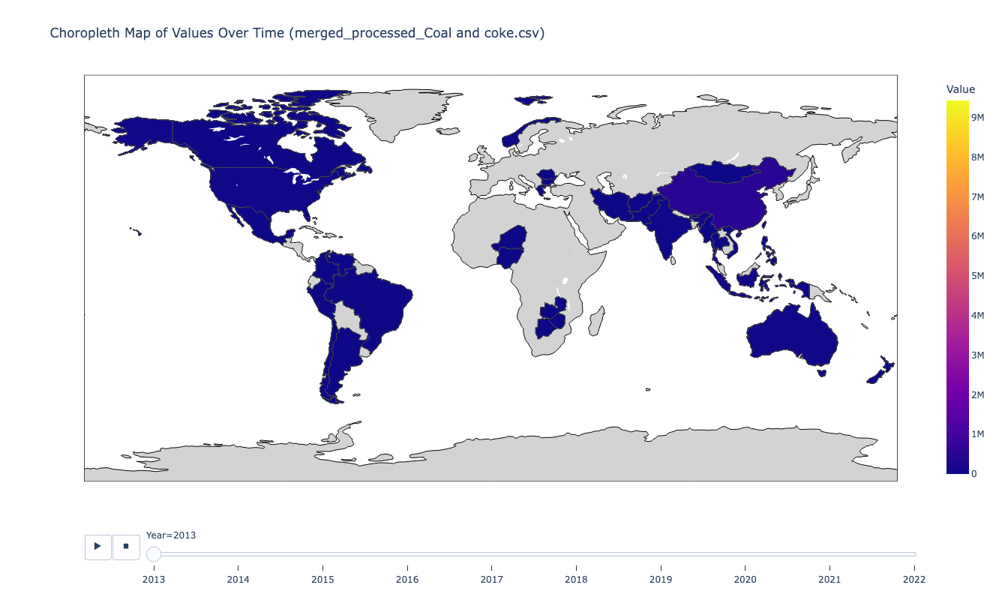

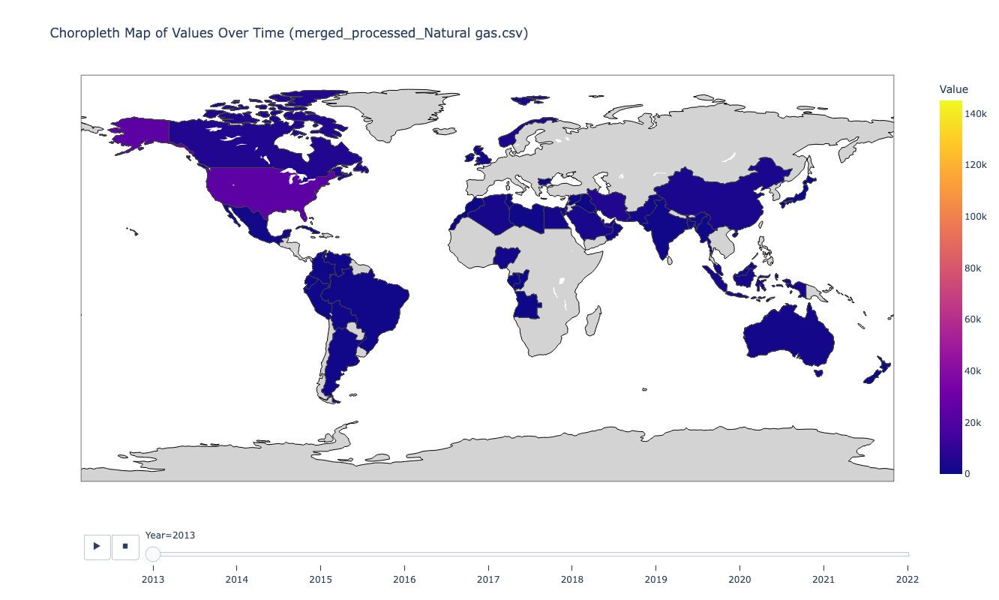

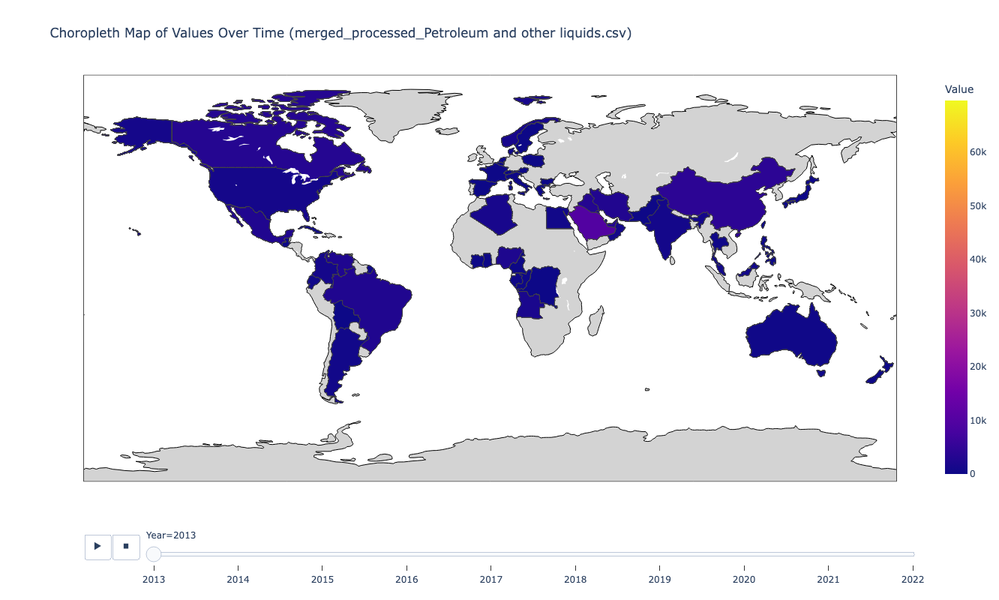

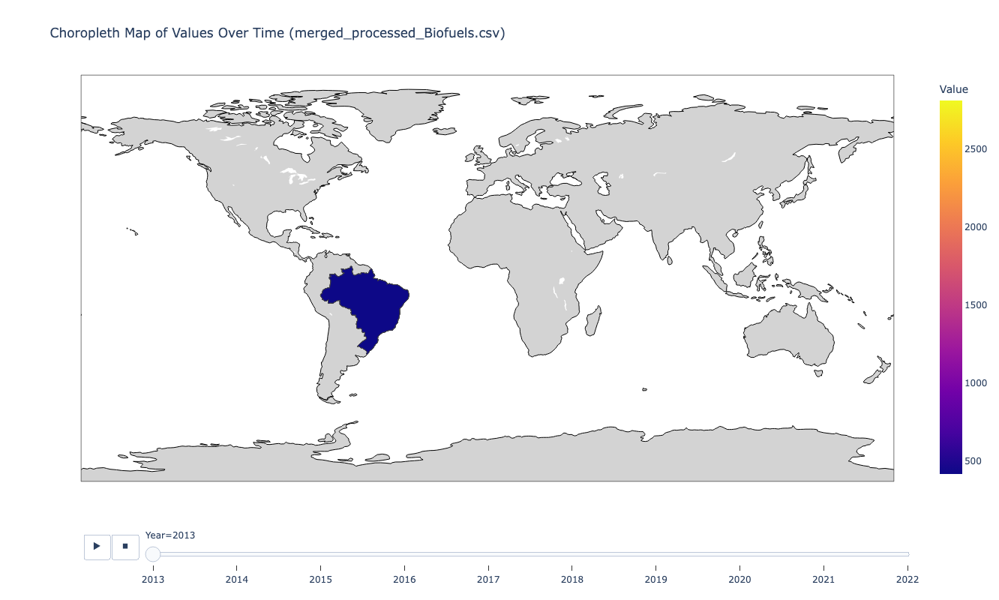

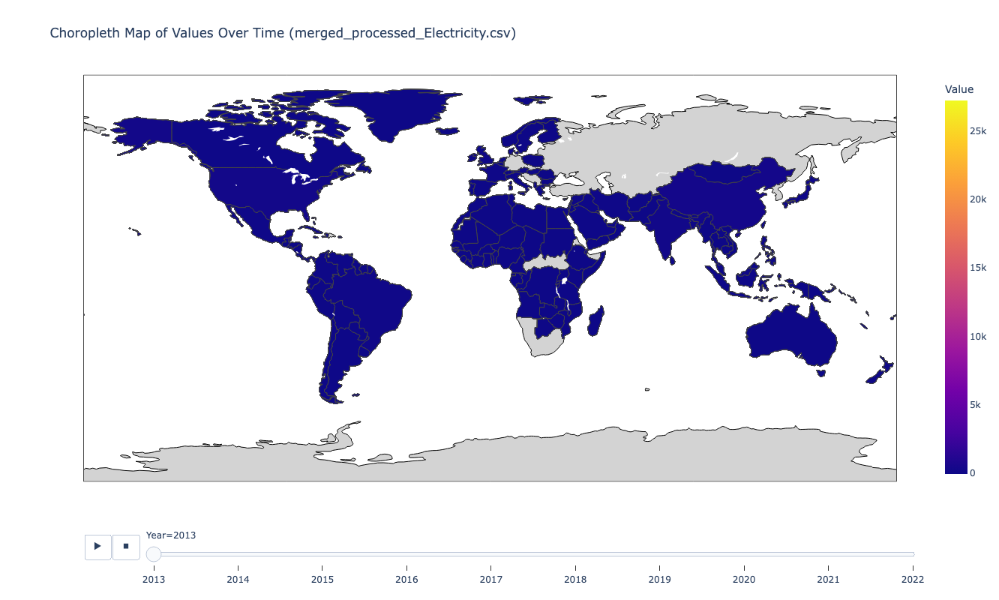

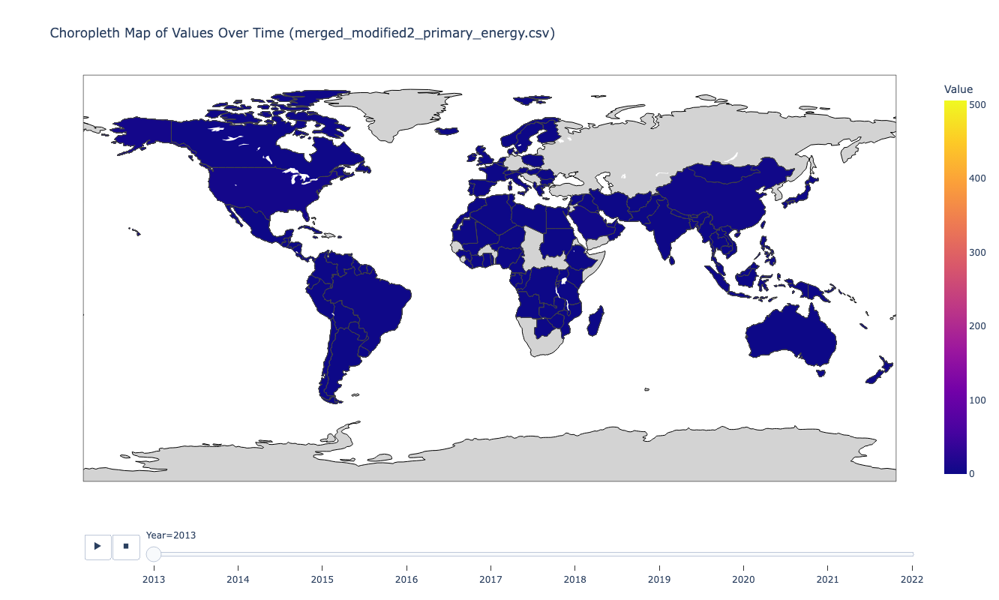

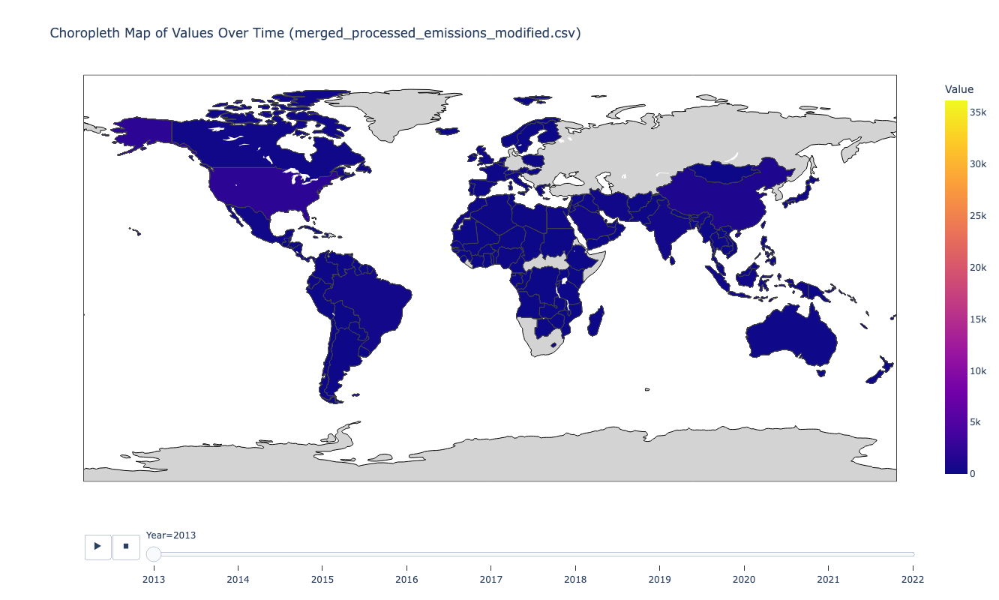

In [119]:
#rows where at least one percentage change value exceeds 100% based on 1980

years = [str(year) for year in range(2013, 2023)]

# Define file names
file_names = [
    "merged_processed_Coal and coke.csv",
    "merged_processed_Natural gas.csv",
    "merged_processed_Petroleum and other liquids.csv",
    "merged_processed_Biofuels.csv",
    "merged_processed_Electricity.csv",
    "merged_modified2_primary_energy.csv",
    "merged_processed_emissions_modified.csv"
]

for file_name in file_names:
    df = pd.read_csv(file_name)
    
    for year in years:
        if year in df.columns:
            df[year] = pd.to_numeric(df[year], errors='coerce')
    
    if '1980' in df.columns:
        df['1980'] = pd.to_numeric(df['1980'], errors='coerce')
    
    # Calculate percentage change from 1980
    for year in years:
        if '1980' in df.columns and year in df.columns:
            change_col = f'% change of {year}'
            df[change_col] = (df[year] / df['1980']) * 100
    
    # Filter rows with % change > 100
    change_columns = [col for col in df.columns if col.startswith('% change of ')]
    df.replace([float('inf'), -float('inf')], np.nan, inplace=True)
    df.dropna(subset=change_columns, inplace=True)
    
    # Filter rows where any percentage change is > 100
    filtered_rows = df[change_columns].apply(lambda x: x > 100, axis=1)
    filtered_df = df.loc[filtered_rows.any(axis=1)]
    
    melted_df = filtered_df.melt(id_vars=['Country'], 
                                 value_vars=years, 
                                 var_name='Year', 
                                 value_name='Value')

    melted_df['Year'] = melted_df['Year'].astype(int)

    fig = px.choropleth(melted_df, 
                        locations="Country", 
                        locationmode='country names',  
                        color="Value", 
                        hover_name="Country", 
                        animation_frame="Year",  
                        title=f"Choropleth Map of Values Over Time ({file_name})",
                        color_continuous_scale=px.colors.sequential.Plasma)

    fig.update_coloraxes(cmin=melted_df['Value'].min(), 
                         cmax=melted_df['Value'].max(), 
                         colorbar_title="Value")

    fig.update_geos(showcoastlines=True, coastlinecolor="Black", showland=True, landcolor="lightgray")

    fig.update_layout(
        width=1200, 
        height=800,  
    )

    fig.show()

# FAILURES SECTION

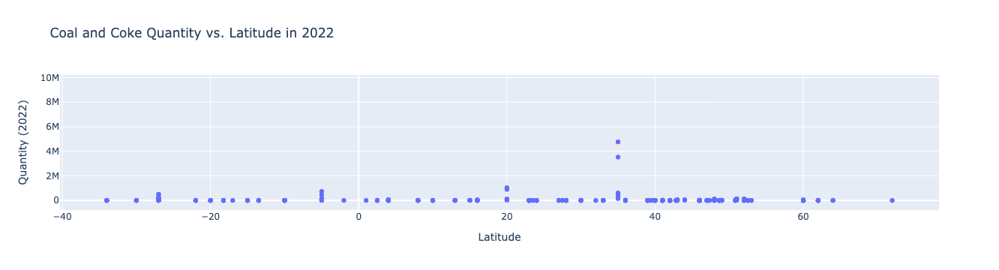

In [278]:
coal = pd.read_csv('merged_processed_Coal and coke.csv')
latitude_col = 'Latitude_x'  
quantity_col = '2022'     

coal[quantity_col] = pd.to_numeric(coal[quantity_col], errors='coerce')
df_filtered = coal[(coal[quantity_col].notna()) & (coal[quantity_col] > 0)]

df_filtered = df_filtered.sort_values(by=quantity_col)

fig = px.scatter(df_filtered, x=latitude_col, y=quantity_col,
                 title='Coal and Coke Quantity vs. Latitude in 2022',
                 labels={latitude_col: 'Latitude', quantity_col: 'Quantity (2022)'})


fig.show()

In [ ]:
df_filtered

In [ ]:
df_coal2 = pd.read_csv('merged_processed_Coal and coke.csv')
df_natural_gas = pd.read_csv('merged_processed_Natural gas.csv')
df_petroleum = pd.read_csv('merged_processed_Petroleum and other liquids.csv')

latitude_col = 'Latitude' 
quantity_col = '2022'      


def preprocess_data(df, source_name):

    df[quantity_col] = pd.to_numeric(df[quantity_col], errors='coerce')
    
    df_filtered = df[(df[quantity_col].notna()) & (df[quantity_col] > 0)].copy()
    
    df_filtered['Source'] = source_name
    
    return df_filtered

df_coal_filtered = preprocess_data(df_coal2, 'Coal and Coke')
df_natural_gas_filtered = preprocess_data(df_natural_gas, 'Natural Gas')
df_petroleum_filtered = preprocess_data(df_petroleum, 'Petroleum and Other Liquids')


df_combined = pd.concat([df_coal_filtered, df_natural_gas_filtered, df_petroleum_filtered])

df_combined = df_combined.sort_values(by=quantity_col)

fig = px.scatter(df_combined, x=latitude_col, y=quantity_col, color='Source',
                 title='Natural Resource Quantity vs. Latitude in 2022',
                 labels={latitude_col: 'Latitude', quantity_col: 'Quantity (2022)', 'Source': 'Resource Type'})

fig.show()

In [ ]:

latitude_col = 'Latitude' 
quantity_col = '2022'  

def preprocess_data(df, source_name):
    df[quantity_col] = pd.to_numeric(df[quantity_col], errors='coerce')
    
    df_filtered = df[(df[quantity_col].notna()) & (df[quantity_col] > 0)].copy()
    
    df_filtered.loc[:, 'Source'] = source_name
    
    return df_filtered


df_coal_filtered = preprocess_data(df_coal2, 'Coal and Coke')
df_natural_gas_filtered = preprocess_data(df_natural_gas, 'Natural Gas')
df_petroleum_filtered = preprocess_data(df_petroleum, 'Petroleum and Other Liquids')


df_combined = pd.concat([df_coal_filtered, df_natural_gas_filtered, df_petroleum_filtered])

def calculate_percentile_range(df, col, lower_percentile=5, upper_percentile=95):
    lower_bound = df[col].quantile(lower_percentile / 100)
    upper_bound = df[col].quantile(upper_percentile / 100)
    return lower_bound, upper_bound


x_min, x_max = calculate_percentile_range(df_combined, latitude_col)
y_min, y_max = calculate_percentile_range(df_combined, quantity_col)


fig = px.scatter(df_combined, x=latitude_col, y=quantity_col, color='Source',
                 title='Natural Resource Quantity vs. Latitude in 2022',
                 labels={latitude_col: 'Latitude', quantity_col: 'Quantity (2022)', 'Source': 'Resource Type'})


fig.update_layout(
    xaxis=dict(range=[x_min, x_max]),
    yaxis=dict(range=[y_min, y_max])
)


fig.show()

In [82]:
latitude_col = 'Latitude'  
longitude_col = 'Longitude' 
quantity_col = '2022'       

def preprocess_data(df, source_name):
    df[quantity_col] = pd.to_numeric(df[quantity_col], errors='coerce')
    
    df_filtered = df[(df[quantity_col].notna()) & (df[quantity_col] > 0)].copy()
    
    df_filtered.loc[:, 'Source'] = source_name
    
    return df_filtered

df_coal_filtered = preprocess_data(df_coal2, 'Coal and Coke')
df_natural_gas_filtered = preprocess_data(df_natural_gas, 'Natural Gas')
df_petroleum_filtered = preprocess_data(df_petroleum, 'Petroleum and Other Liquids')


df_combined = pd.concat([df_coal_filtered, df_natural_gas_filtered, df_petroleum_filtered])


def calculate_percentile_range(df, col, lower_percentile=5, upper_percentile=95):
    lower_bound = df[col].quantile(lower_percentile / 100)
    upper_bound = df[col].quantile(upper_percentile / 100)
    return lower_bound, upper_bound

x_min_lat, x_max_lat = calculate_percentile_range(df_combined, latitude_col)
x_min_lon, x_max_lon = calculate_percentile_range(df_combined, longitude_col)
y_min, y_max = calculate_percentile_range(df_combined, quantity_col)


fig = px.scatter(df_combined, x=longitude_col, y=quantity_col, color='Source',
                 title='Natural Resource Quantity vs. Longitude in 2022',
                 labels={longitude_col: 'Longitude', quantity_col: 'Quantity (2022)', 'Source': 'Resource Type'})

fig.update_layout(
    xaxis=dict(range=[x_min_lon, x_max_lon]),
    yaxis=dict(range=[y_min, y_max])
)

fig.show()

NameError: name 'df_coal2' is not defined

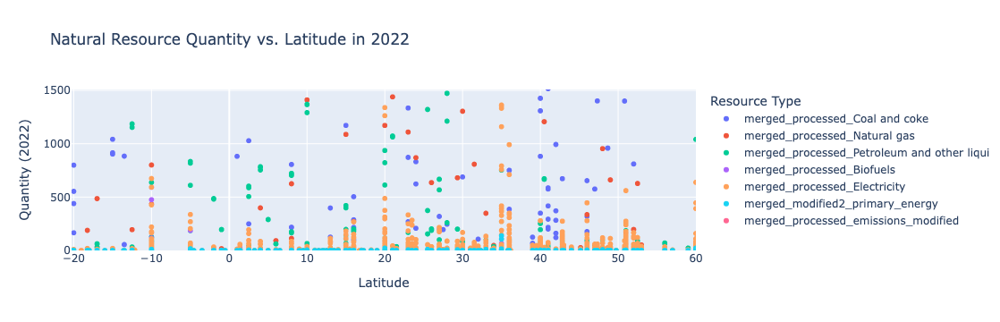

In [83]:
files = [
    'merged_processed_Coal and coke.csv',
    'merged_processed_Natural gas.csv',
    'merged_processed_Petroleum and other liquids.csv',
    'merged_processed_Biofuels.csv',
    'merged_processed_Electricity.csv',
    'merged_modified2_primary_energy.csv',"merged_processed_emissions_modified.csv"
]

latitude_col = 'Latitude' 
quantity_col = '2022'      

def preprocess_data(df, source_name):
    if quantity_col not in df.columns:
        print(f"Warning: '{quantity_col}' column not found in dataset '{source_name}'")
        return pd.DataFrame()  
    
    df[quantity_col] = pd.to_numeric(df[quantity_col], errors='coerce')
    

    df_filtered = df[(df[quantity_col].notna()) & (df[quantity_col] > 0)].copy()
    
    df_filtered.loc[:, 'Source'] = source_name
    
    return df_filtered

dfs_filtered = []
for file in files:
    source_name = file.split('.')[0] 
    df = pd.read_csv(file)
    df_filtered = preprocess_data(df, source_name)
    if not df_filtered.empty:
        dfs_filtered.append(df_filtered)

if dfs_filtered:
    df_combined = pd.concat(dfs_filtered)
    
    def calculate_percentile_range(df, col, lower_percentile=5, upper_percentile=95):
        lower_bound = df[col].quantile(lower_percentile / 100)
        upper_bound = df[col].quantile(upper_percentile / 100)
        return lower_bound, upper_bound

    x_min, x_max = calculate_percentile_range(df_combined, latitude_col)
    y_min, y_max = calculate_percentile_range(df_combined, quantity_col)

    fig = px.scatter(df_combined, x=latitude_col, y=quantity_col, color='Source',
                     title='Natural Resource Quantity vs. Latitude in 2022',
                     labels={latitude_col: 'Latitude', quantity_col: 'Quantity (2022)', 'Source': 'Resource Type'})

    fig.update_layout(
        xaxis=dict(range=[x_min, x_max]),
        yaxis=dict(range=[y_min, y_max])
    )

    fig.show()
else:
    print("No data available for plotting.")

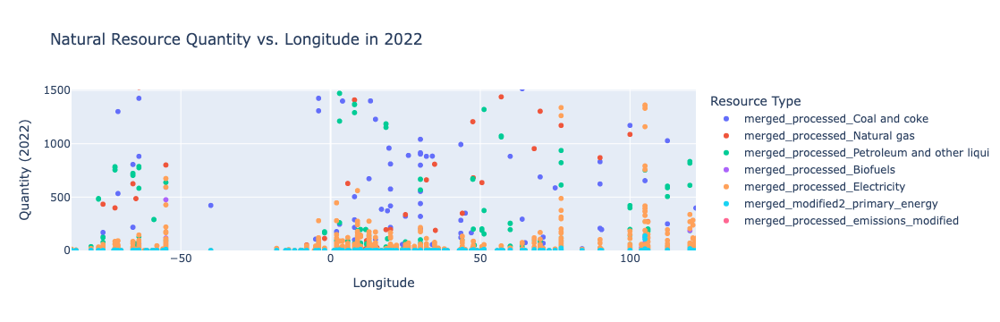

In [84]:
longitude_col = 'Longitude'  
quantity_col = '2022'        

def preprocess_data(df, source_name):
    if quantity_col not in df.columns:
        print(f"Warning: '{quantity_col}' column not found in dataset '{source_name}'")
        return pd.DataFrame()  
    
    df[quantity_col] = pd.to_numeric(df[quantity_col], errors='coerce')
    
    df_filtered = df[(df[quantity_col].notna()) & (df[quantity_col] > 0)].copy()
    
    df_filtered.loc[:, 'Source'] = source_name
    
    return df_filtered

dfs_filtered = []
for file in files:
    source_name = file.split('.')[0] 
    df = pd.read_csv(file)
    df_filtered = preprocess_data(df, source_name)
    if not df_filtered.empty:
        dfs_filtered.append(df_filtered)

if dfs_filtered:
    df_combined = pd.concat(dfs_filtered)
    
    def calculate_percentile_range(df, col, lower_percentile=5, upper_percentile=95):
        lower_bound = df[col].quantile(lower_percentile / 100)
        upper_bound = df[col].quantile(upper_percentile / 100)
        return lower_bound, upper_bound

    x_min, x_max = calculate_percentile_range(df_combined, longitude_col)
    y_min, y_max = calculate_percentile_range(df_combined, quantity_col)

    fig = px.scatter(df_combined, x=longitude_col, y=quantity_col, color='Source',
                     title='Natural Resource Quantity vs. Longitude in 2022',
                     labels={longitude_col: 'Longitude', quantity_col: 'Quantity (2022)', 'Source': 'Resource Type'})

    fig.update_layout(
        xaxis=dict(range=[x_min, x_max]),
        yaxis=dict(range=[y_min, y_max])
    )

    fig.show()
else:
    print("No data available for plotting.")

In [85]:
dfT= pd.read_csv("merged_processed_emissions_modified.csv")
dfT

,Country,1949,1950,1951,1952,1953,1954,1955,1956,1957,...,2017,2018,2019,2020,2021,2022,ISO 3166 Country Code,Latitude,Longitude,Category
0,Emissions,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CO2emissions(MMtonnesCO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3229.106490498,3173.837904551,3050.515706002,2674.174407197,2861.862122568,2810.895446026,NaN,NaN,NaN,NaN
2,Coalandcoke(MMtonnesCO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,885.8347672131258,837.4372789408834,686.1986177198614,553.60432220144,625.2556464438163,638.1503754676833,NaN,NaN,NaN,NaN
3,Consumednaturalgas(MMtonnesCO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,771.853227747,760.421619714,785.818991333,750.968713961,788.586325812,672.944252201,NaN,NaN,NaN,NaN
4,Petroleumandotherliquids(MMtonnesCO2),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1571.418495536,1575.979005895,1578.4980969494302,1369.6013710344841,1448.0201503162598,1499.8008183615273,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3318,Emissions,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3319,CO2emissions(MMtonnesCO2),2206.690829,2382.046176,2526.687327,2473.373964,2536.892888,2422.252560,2684.786146,2777.042758,2756.562392,...,5131.529178,5277.882471,5146.992588,4583.690108,4904.569835,4941.235774,NaN,NaN,NaN,NaN
3320,Coalandcoke(MMtonnesCO2),1117.538985,1151.600346,1166.858975,1052.386511,1057.069608,904.191799,1037.883229,1054.597765,1003.746034,...,1317.951988,1262.555409,1077.519881,876.195454,1002.650633,938.649433,NaN,NaN,NaN,NaN
3321,Consumednaturalgas(MMtonnesCO2),269.537229,312.826758,369.725933,396.144693,414.852766,437.259069,472.164274,504.395476,534.718185,...,1470.964449,1626.90757,1684.623741,1653.000683,1656.119591,1742.143174,NaN,NaN,NaN,NaN
